 ==> Librerías, clases y métodos cargados:
 +++ "dt"                           +++ "os" 
 +++ "json" v:2.0.9                 +++ "pd" (pandas) v:0.18.1
 +++ "locale"                       +++ "plt" 
 +++ "math"                         +++ "re" v:2.2.1
 +++ "np" (numpy) v:1.11.1          +++ "sns" (seaborn) v:0.7.0
 +++ "sys" 
 ** "Colormap", "Line2D", "Normalize", "OrderedDict", "PathPatch", "namedtuple", "time"
 ==> Pretty printing funcs:
print_blue, print_bold, print_boldu, print_cyan, print_err, print_green, print_grey, print_greyb, print_info, print_infob, print_magenta, print_ok, print_red, print_redb, print_secc, print_tree_dict, print_warn, print_white, print_yellow, print_yellowb, printcolor
If you are in a jupyter notebook, insert this:
%matplotlib inline
%config InlineBackend.figure_format='retina'
If you are working with GEO data, insert this:
import geopandas as gpd
import shapely.geometry as sg
import cartopy.crs as ccrs


/Users/uge/anaconda/envs/py35/lib/python3.5/site-packages/matplotlib/__init__.py:1350: UserWarning:  This call to matplotlib.use() has no effect
because the backend has already been chosen;
matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


***TIMEIT get_all_data TOOK: 1.052 s
                          kWh     t_ref  n_jump  n_exec   p_max  p_mean  p_min
ts                                                                            
2016-09-14 09:00:00  0.280975  0.999865       0       0   865.0   281.0  185.0
2016-09-14 10:00:00  0.348163  1.000116       0       0   422.0   348.0  273.0
2016-09-14 11:00:00  0.347181  1.000035       0       0   883.0   347.0  277.0
2016-09-14 12:00:00  0.312149  0.999837       0       0   391.0   312.0  269.0
2016-09-14 13:00:00  0.144251  0.331557       0       0  2564.0   435.0  284.0
       count  mean  std  min  25%  50%  75%  max
ldr  2725278   251  234   11   33  162  478  748


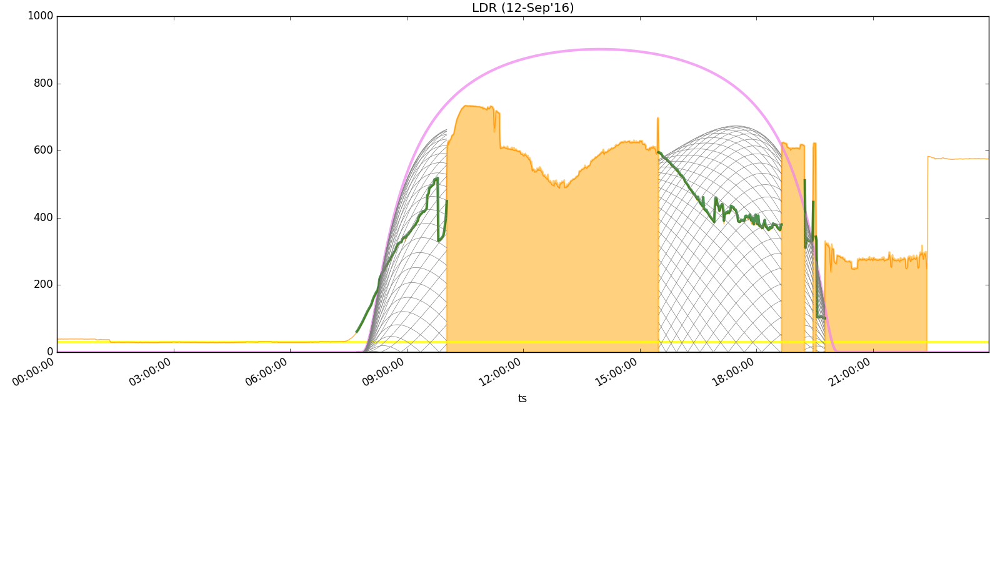

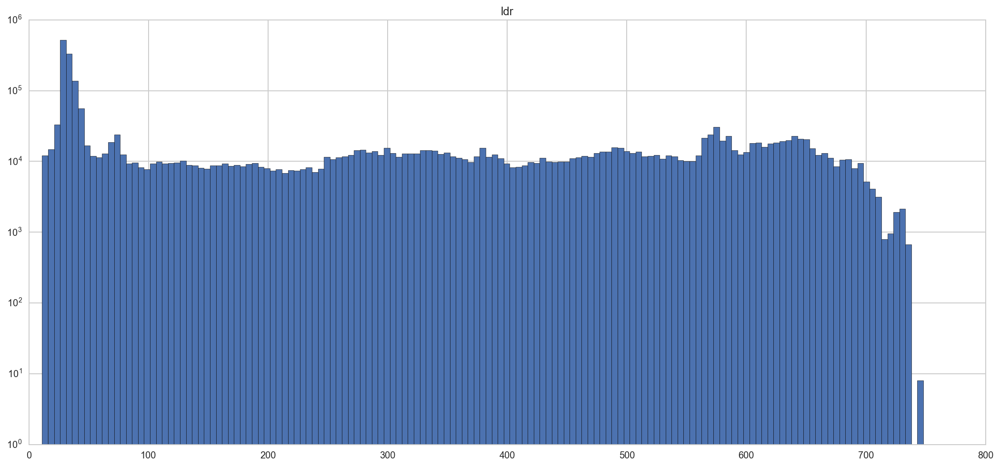

In [2]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
from IPython.display import Image, HTML

import random
import math
import pysolar
import datetime as dt
import pytz
import matplotlib.dates as mpd
import scipy
from scipy import signal
from scipy.signal import medfilt
import numexpr as ne

from datacharm import *
from datacharm.dataplots import tableau20, ch_color
from datacharm.datasun import sun_position

from enerpi.base import timeit
from enerpi.api import enerpi_data_catalog
from enerpi.enerplot import plot_tile_last_24h, plot_power_consumption_hourly
from enerpi.process import separa_ldr_artificial_natural, get_solar_day
from enerpi.radsolar import ajuste_ldr_con_barrido_irrad_inc, local_maxima_minima


LAT = 38.631463
LONG = -0.866402
ELEV_M = 500
TZ = pytz.timezone('Europe/Madrid')
FS = (16, 10)


def _tslim(ax, h0=12, hf=22, m0=0, mf=0):
    xlim = [mpd.num2date(x, tz=TZ) for x in ax.get_xlim()]
    new = [mpd.date2num(d.replace(hour=h, minute=m)) for d, h, m in zip(xlim, [h0, hf], [m0, mf])]
    ax.set_xlim(new)
    return ax


def set_sun_times(df, tz=TZ, lat_deg=LAT, long_deg=LONG, offset='5min'):
    if df.index[-1].date() == df.index[0].date():
        # Same day:
        ts_day = pd.Timestamp(df.index[0].date(), tz=tz)
        sunrise, sunset = pysolar.util.get_sunrise_sunset(lat_deg, long_deg, ts_day + pd.Timedelta('12h'))
        delta = pd.Timedelta(offset)
        sunrise, sunset = [sunrise - delta, sunset + delta]
        df['sun'] = False
        df.loc[sunrise:sunset, 'sun'] = True
        return df
    else:
        print_err('IMPLEMENTAR!')
        assert()


sns.set_style('whitegrid')        

# Catálogo y lectura de todos los datos.
cat = enerpi_data_catalog()
data, data_s = cat.get_all_data()
print_info(data_s.tail())

LDR = pd.DataFrame(data.ldr).tz_localize(TZ)
print_cyan(LDR.describe().T.astype(int))
LDR.hist(bins=(LDR.max() - LDR.min() + 1).values[0] // 5, log=True, figsize=(18, 8))

Image('/Users/uge/Desktop/LDR_analysis/LDR_análisis_día_2016_09_12.png')

In [3]:
path_st = '/Users/uge/Desktop/LDR_analysis/POIS_ident_1s.h5'
# data_homog, data_rs, pois = genera_pois_de_all_data_LDR(path_st)

pois = pd.read_hdf(path_st, 'POIS')
data_homog = pd.read_hdf(path_st, 'data_homog')
data_rs = pd.read_hdf(path_st, 'data_rs')
print(len(pois), pois.columns)

data = data_rs.join(data_homog.ldr.rename('raw_ldr')).drop('sun', axis=1)
data['mf_dmax'] = data['median_filter'].rolling(10).max() - data['median_filter']
data['mf_dmin'] = data['median_filter'] - data['median_filter'].rolling(10).min()
data['mf_dif'] = data['mf_dmax'] - data['mf_dmin']

932 Index(['fr_sun', 'seconds', 'alt_sun_ini', 'alt_sun_fin', 'altitud', 'ldr_mean', 'ldr_min', 'ldr_max', 'ldr_median', 'ldr_std', 'pendiente_tot', 'inicio', 'fin', 'pendiente_i',
       'pendiente_f', 'pendiente_last_mf', 'ts_ini', 'ts_fin', 'step', 'pendiente_salto', 'is_poi_to_label'],
      dtype='object')


In [386]:
data['mf_dif'].values[:100]

array([  nan,   nan,   nan,   nan,   nan,   nan,   nan,   nan,   nan,
          0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0., -656., -656., -656., -656., -656., -656., -656.,
       -656., -656.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,   -1.,   -1.,   -1.,   -1.,
         -1.,   -1.,   -1.,   -1.,   -1.,    0.,    0.,    0.,    0.,    0.])

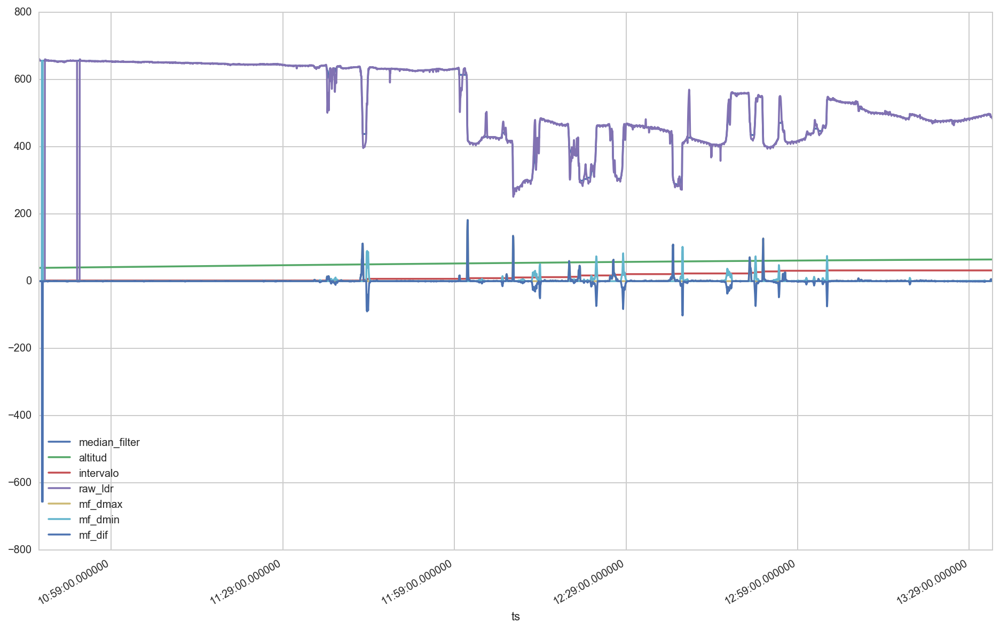

In [7]:
data.iloc[:10000].plot(figsize=FS)

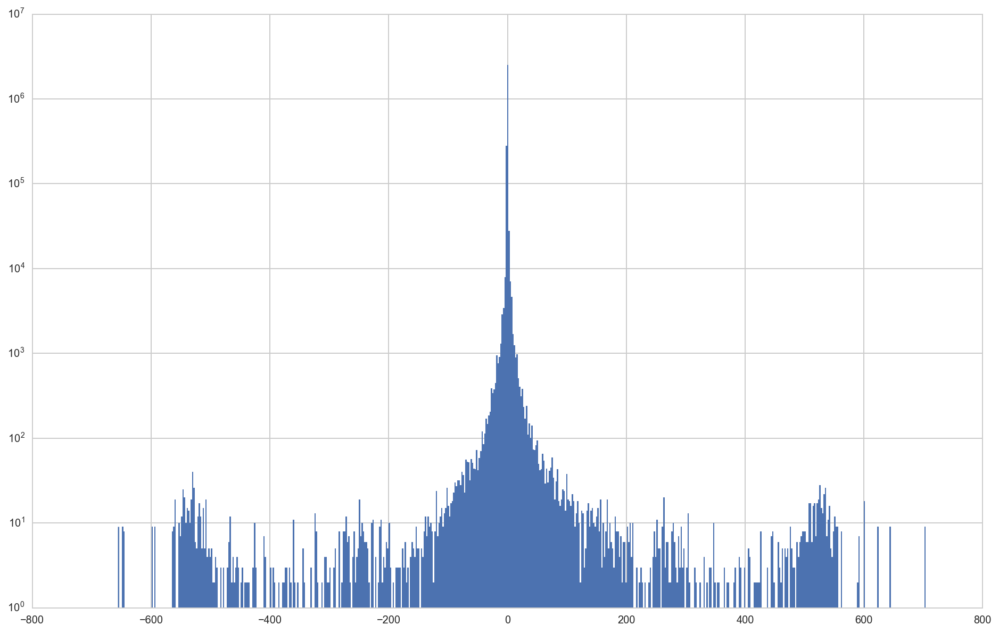

In [9]:
data['mf_dif'].hist(figsize=FS, lw=0, bins=600, log=True)

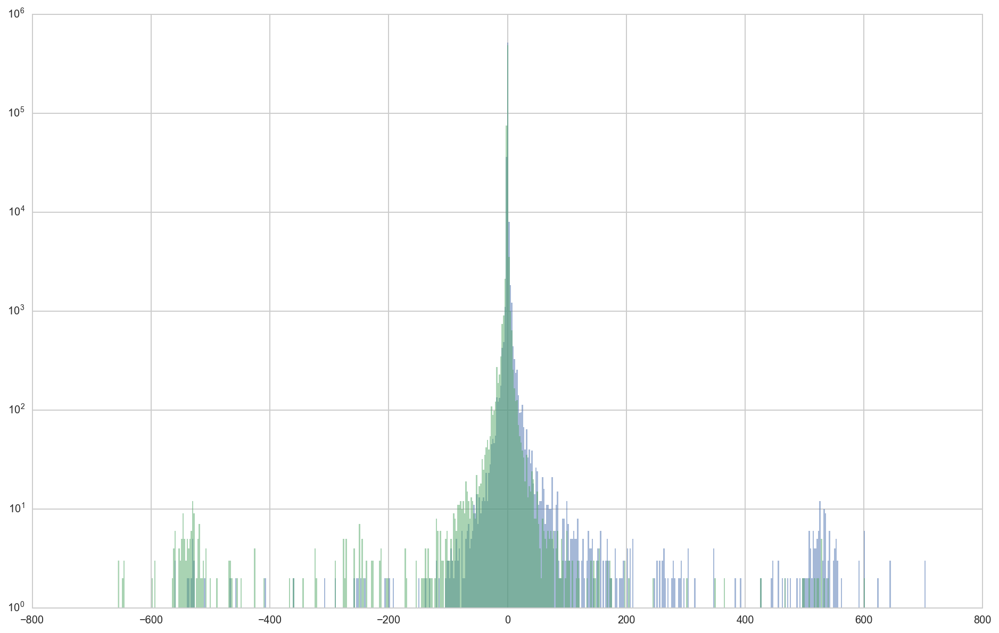

In [12]:
ax = data['mf_dif'].resample('5s').max().hist(figsize=FS, lw=0, bins=600, log=True, alpha=.5)
ax = data['mf_dif'].resample('5s').min().hist(ax=ax, lw=0, bins=600, log=True, alpha=.5)

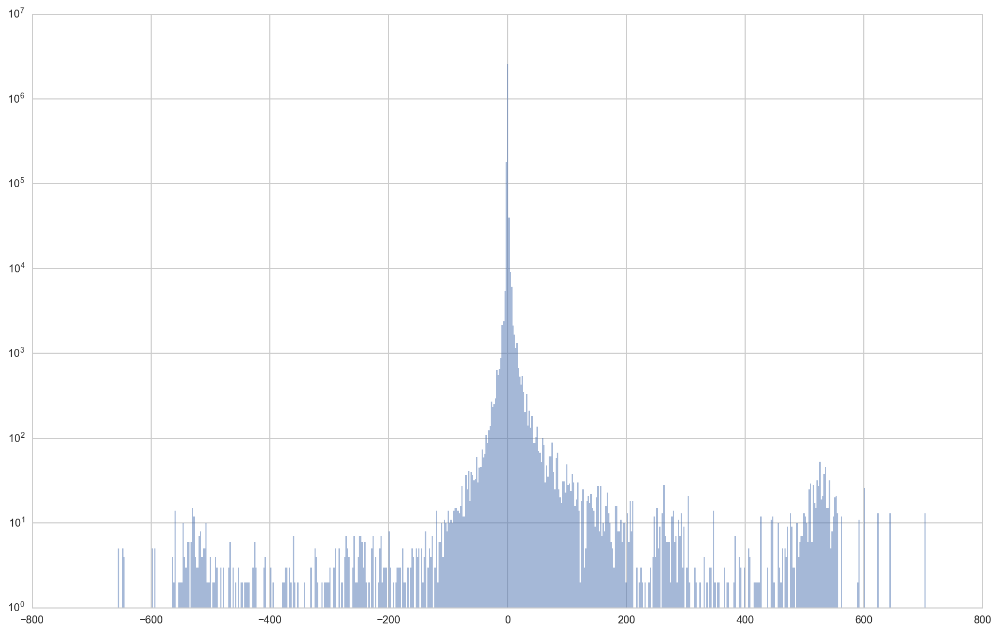

In [13]:
ax = data['mf_dif'].rolling(5, center=True).max().hist(figsize=FS, lw=0, bins=600, log=True, alpha=.5)

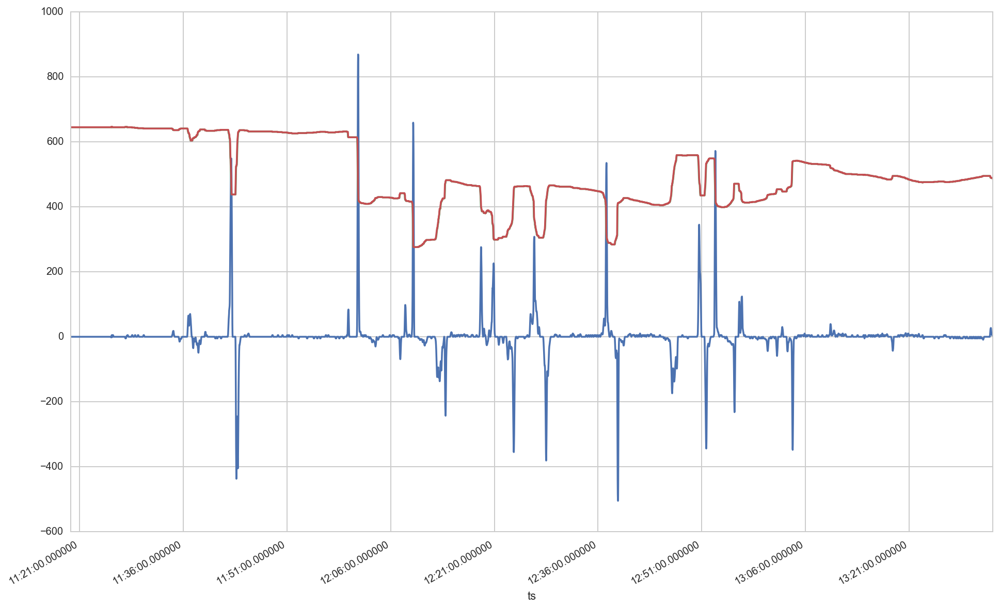

In [17]:
ax = data['mf_dif'].rolling(5, center=True).sum().iloc[2000:10000].plot(figsize=FS)
data['median_filter'].iloc[2000:10000].plot(ax=ax)
data['median_filter'].rolling(5, center=True).max().iloc[2000:10000].plot(ax=ax)

39.0 3027.0


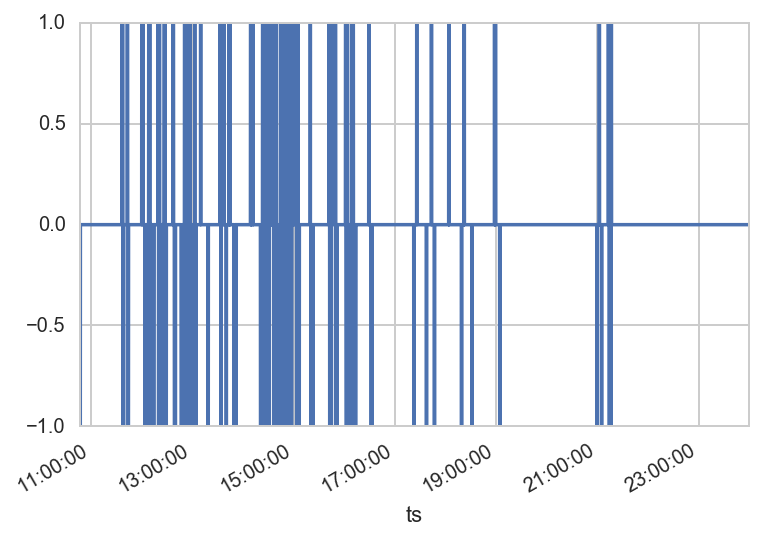

In [62]:
subdata = data.loc['2016-08-12': '2016-08-12'].copy()
#subdata['evento'] = 0
subdata.loc[subdata['mf_dif'] > 5, 'evento'] = 1
subdata.loc[subdata['mf_dif'] < -5, 'evento'] = -1
subdata['ch_evento'] = subdata.evento.fillna(0).cumsum().diff() #subdata.evento.fillna(method='ffill').diff().fillna(0)
print(subdata.evento.sum(), subdata.evento.abs().sum())
subdata.evento.fillna(0).cumsum().diff().plot()

In [53]:
ch_evento = subdata.evento.diff().fillna(0)
ch_evento[ch_evento.abs() > 0]

ts
2016-08-12 14:11:30+02:00   -2.0
2016-08-12 14:34:10+02:00   -2.0
2016-08-12 14:38:05+02:00    2.0
2016-08-12 14:50:48+02:00    2.0
Name: evento, dtype: float64

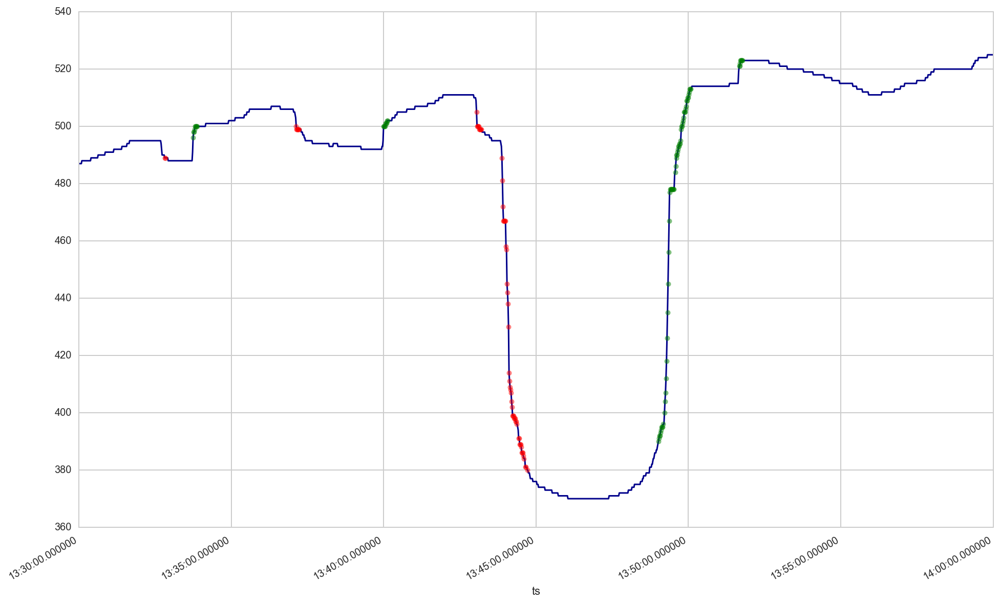

In [63]:
t0, tf = '13:30', '14:00'

ax = subdata.median_filter.between_time(t0, tf).plot(figsize=FS, lw=1.5, color='darkblue')
subdata.median_filter[subdata.ch_evento < 0].between_time(t0, tf).plot(lw=0, marker='o', markersize=5, alpha=.5, color='green', ax=ax)
subdata.median_filter[subdata.ch_evento > 0].between_time(t0, tf).plot(lw=0, marker='o', markersize=5, alpha=.5, color='red', ax=ax)

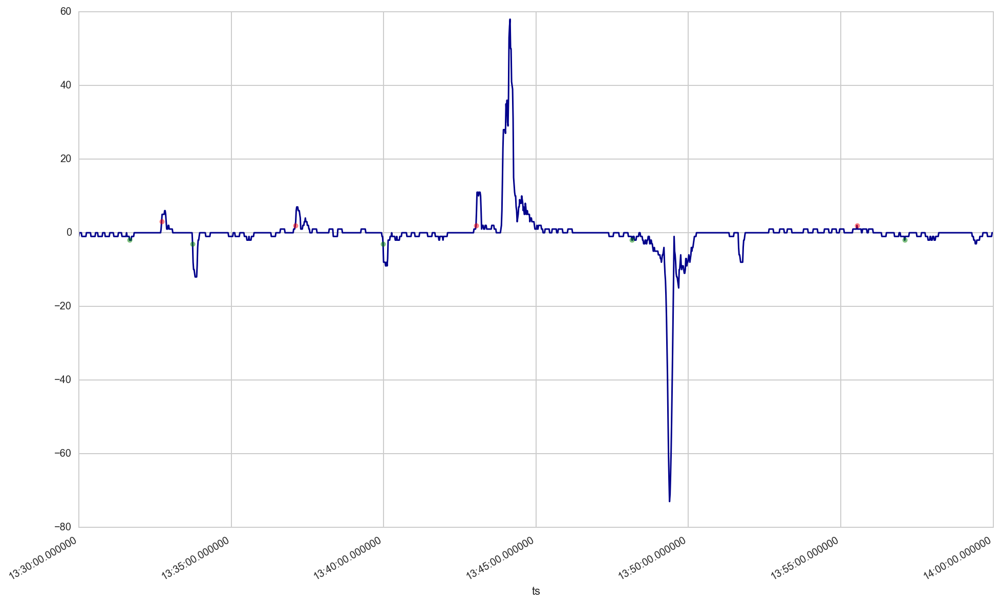

In [55]:
ax = subdata.mf_dif.between_time(t0, tf).plot(figsize=FS, lw=1.5, color='darkblue')
subdata.mf_dif[subdata.ch_evento < 0].between_time(t0, tf).plot(lw=0, marker='o', markersize=5, alpha=.5, color='green', ax=ax)
subdata.mf_dif[subdata.ch_evento > 0].between_time(t0, tf).plot(lw=0, marker='o', markersize=5, alpha=.5, color='red', ax=ax)

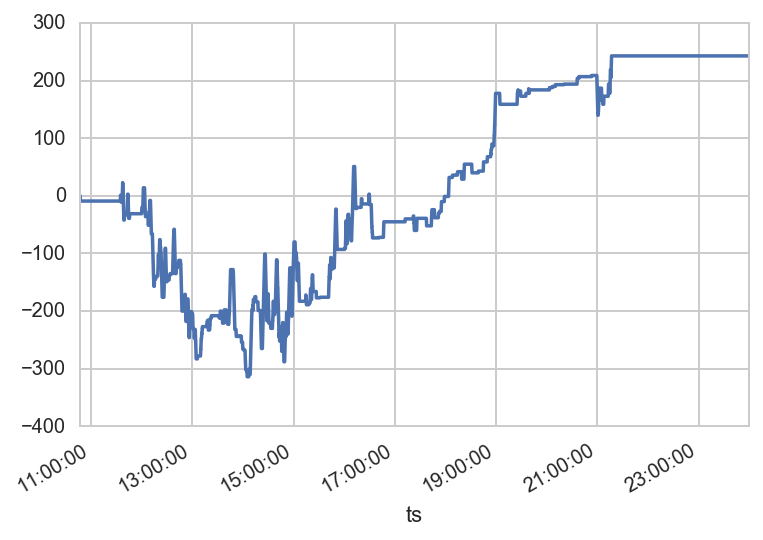

In [58]:
subdata.evento.fillna(0).cumsum().plot()


In [297]:
from statsmodels.nonparametric.smoothers_lowess import lowess

lowess?

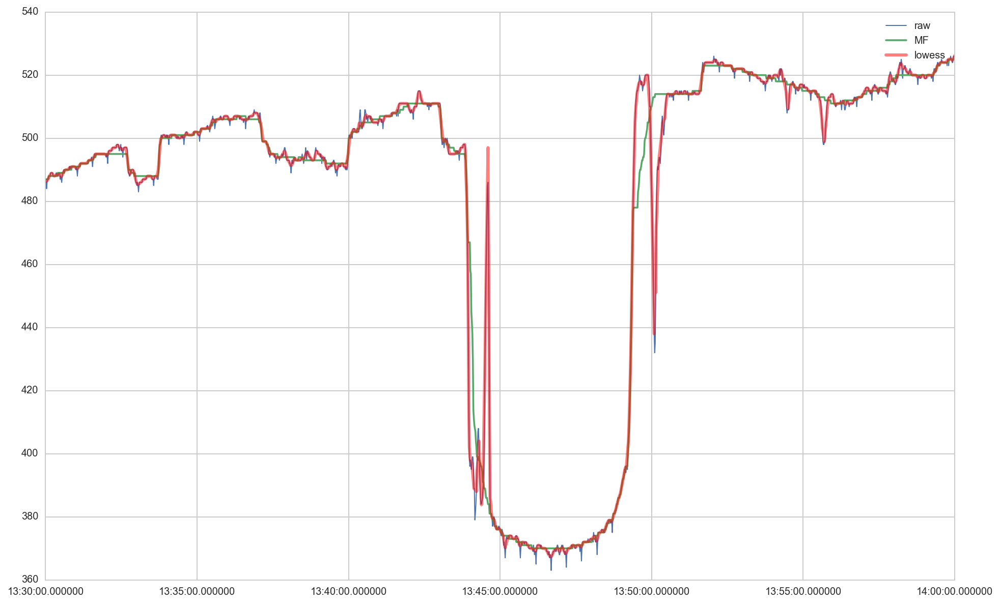

In [92]:
result = lowess(subdata.between_time(t0, tf).raw_ldr, subdata.between_time(t0, tf).index.values, frac=.005)
x_smooth = result[:,0]
y_smooth = result[:,1]

#tot_result = lowess(data.pressure, data.time.values, frac=0.1)
#x_tot_smooth = tot_result[:,0]
#y_tot_smooth = tot_result[:,1]

fig, ax = plt.subplots(figsize=FS)
ax.plot(subdata.between_time(t0, tf).index, subdata.between_time(t0, tf).raw_ldr, label="raw", lw=1)
ax.plot(subdata.between_time(t0, tf).index, subdata.between_time(t0, tf).median_filter, label="MF")
#ax.plot(x_tot_smooth, y_tot_smooth, label="lowess 1%", linewidth=3, color="g")
ax.plot(subdata.between_time(t0, tf).index, y_smooth, label="lowess", linewidth=3, color="r", alpha=.5)
plt.legend()

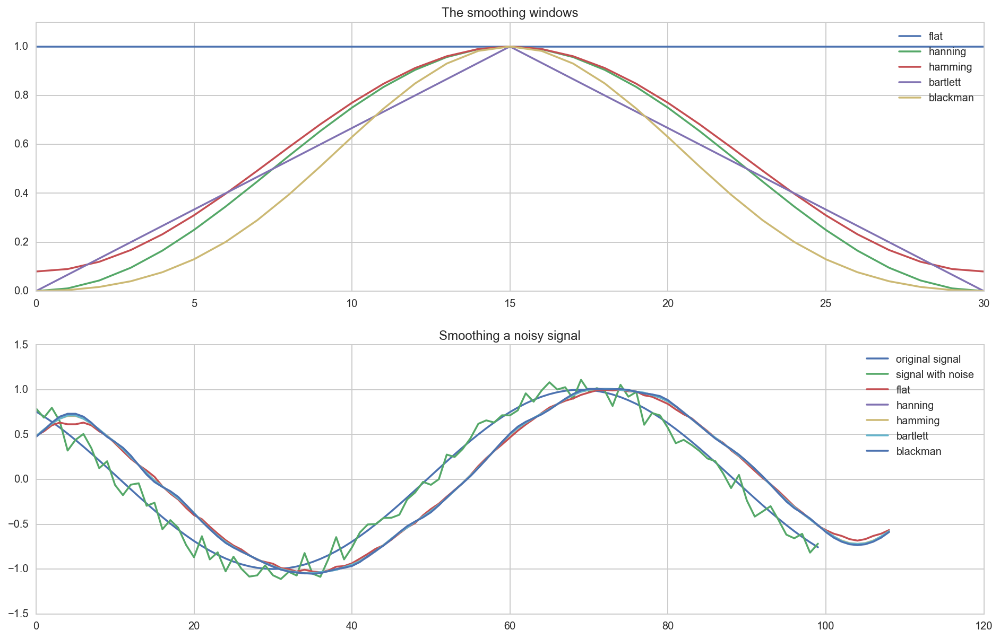

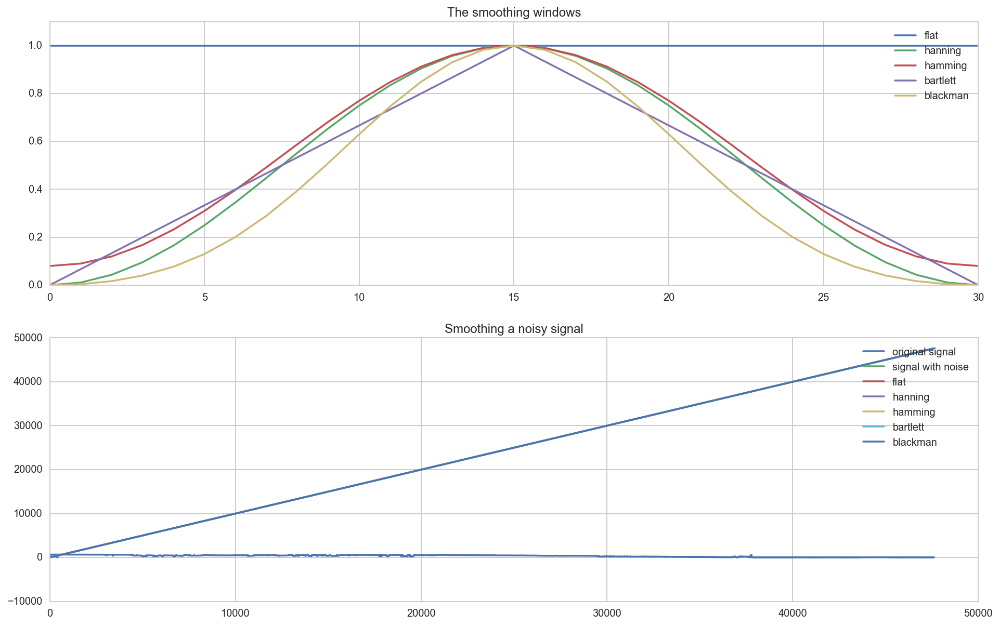

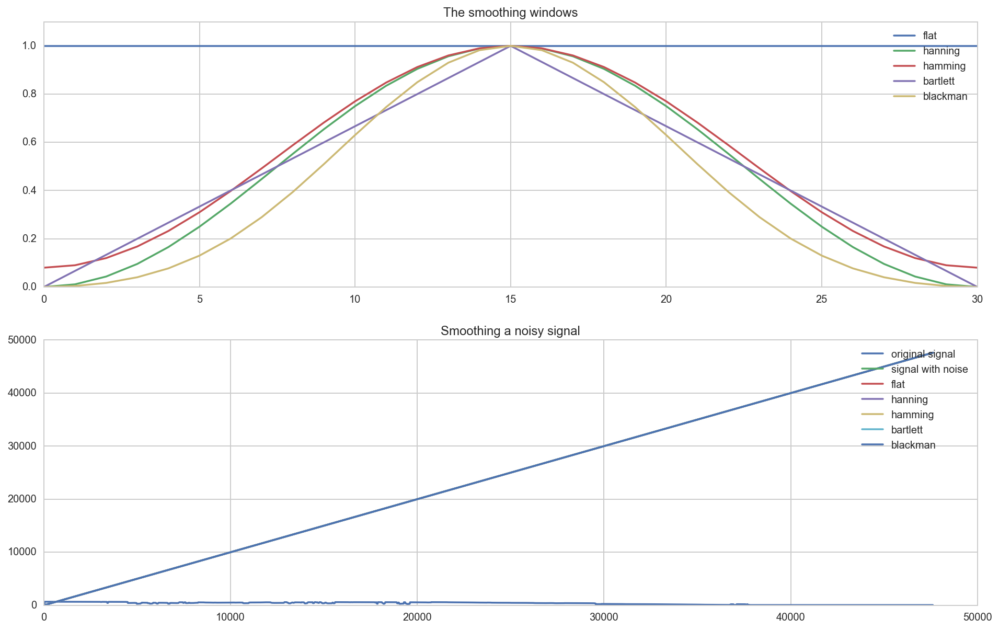

In [111]:
import numpy

def smooth(x,window_len=11,window='hanning'):
    """smooth the data using a window with requested size.

    This method is based on the convolution of a scaled window with the signal.
    The signal is prepared by introducing reflected copies of the signal
    (with the window size) in both ends so that transient parts are minimized
    in the begining and end part of the output signal.

    input:
        x: the input signal
        window_len: the dimension of the smoothing window; should be an odd integer
        window: the type of window from 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'
            flat window will produce a moving average smoothing.

    output:
        the smoothed signal

    example:

    t=linspace(-2,2,0.1)
    x=sin(t)+randn(len(t))*0.1
    y=smooth(x)

    see also:

    numpy.hanning, numpy.hamming, numpy.bartlett, numpy.blackman, numpy.convolve
    scipy.signal.lfilter

    TODO: the window parameter could be the window itself if an array instead of a string
    NOTE: length(output) != length(input), to correct this: return y[(window_len/2-1):-(window_len/2)] instead of just y.
    """

    if x.ndim != 1:
        raise ValueError("smooth only accepts 1 dimension arrays.")

    if x.size < window_len:
        raise (ValueError, "Input vector needs to be bigger than window size.")


    if window_len<3:
        return x


    if not window in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
        raise ValueError("Window is on of 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'")


    s=numpy.r_[x[window_len-1:0:-1],x,x[-1:-window_len:-1]]
    #print(len(s))
    if window == 'flat': #moving average
        w=numpy.ones(window_len,'d')
    else:
        w=eval('numpy.'+window+'(window_len)')

    y=numpy.convolve(w/w.sum(),s,mode='valid')
    return y




from numpy import *
from pylab import *

def smooth_demo(data=None):
    
    if data is None:
        t=linspace(-4,4,100)
        x=sin(t)
        xn=x+randn(len(t))*0.1
        y=smooth(x)
    else:
        x = data.values
        xn = np.array(range(len(data.index)))
        y=smooth(data)
    ws=31

    figure(figsize=FS)
    subplot(211)
    plot(ones(ws))

    windows=['flat', 'hanning', 'hamming', 'bartlett', 'blackman']

    hold(True)
    for w in windows[1:]:
        eval('plot('+w+'(ws) )')

    axis([0,30,0,1.1])

    legend(windows)
    title("The smoothing windows")
    subplot(212)
    plot(x)
    plot(xn)
    for w in windows:
        plot(smooth(xn,10,w))
    l=['original signal', 'signal with noise']
    l.extend(windows)

    legend(l)
    title("Smoothing a noisy signal")
    show()
    

smooth_demo()
smooth_demo(subdata.raw_ldr)
smooth_demo(subdata.median_filter)

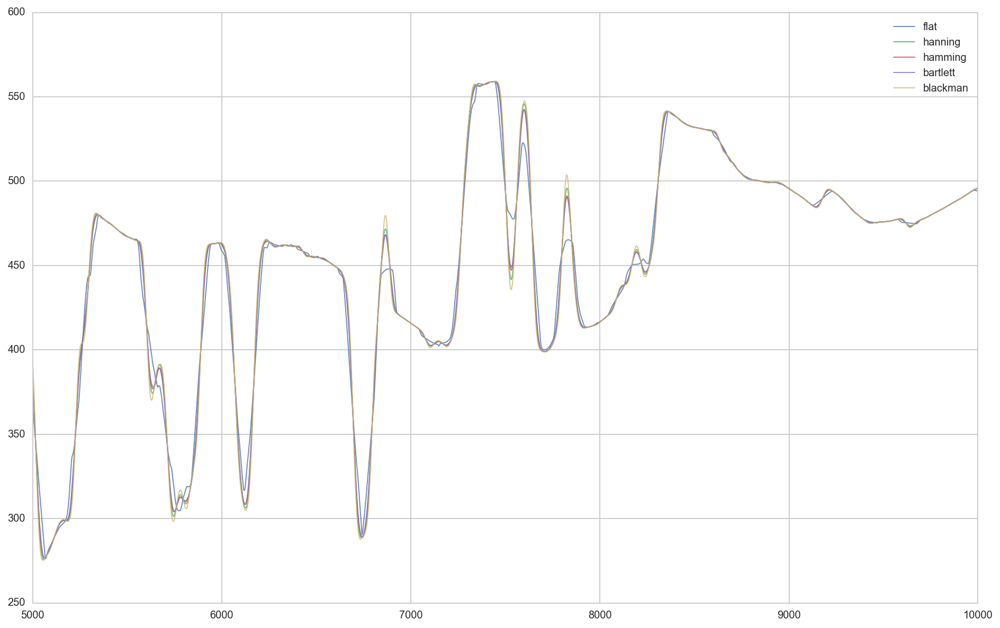

In [121]:
ss = []
for w in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
    #subdata[w] = smooth(subdata.median_filter,window_len=11,window=w)    
    ss.append(pd.Series(smooth(subdata.raw_ldr,window_len=100,window=w), name=w))
#subdata.plot(figsize=FS)
pd.concat(ss, axis=1).iloc[5000:10000].plot(figsize=FS, lw=1, alpha=.8)

In [323]:
data.columns

Index(['median_filter', 'altitud', 'intervalo', 'raw_ldr', 'mf_dmax', 'mf_dmin', 'mf_dif'], dtype='object')

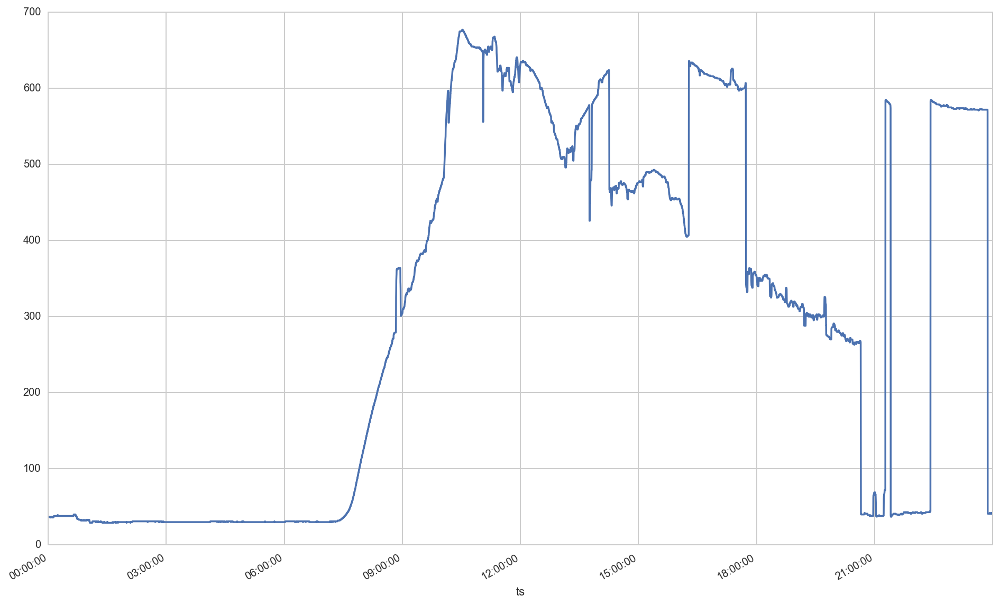

In [3]:
str_day = '2016-09-05'
day = data.loc[str_day:str_day].copy()
day.median_filter.iloc[::5].plot(figsize=FS)

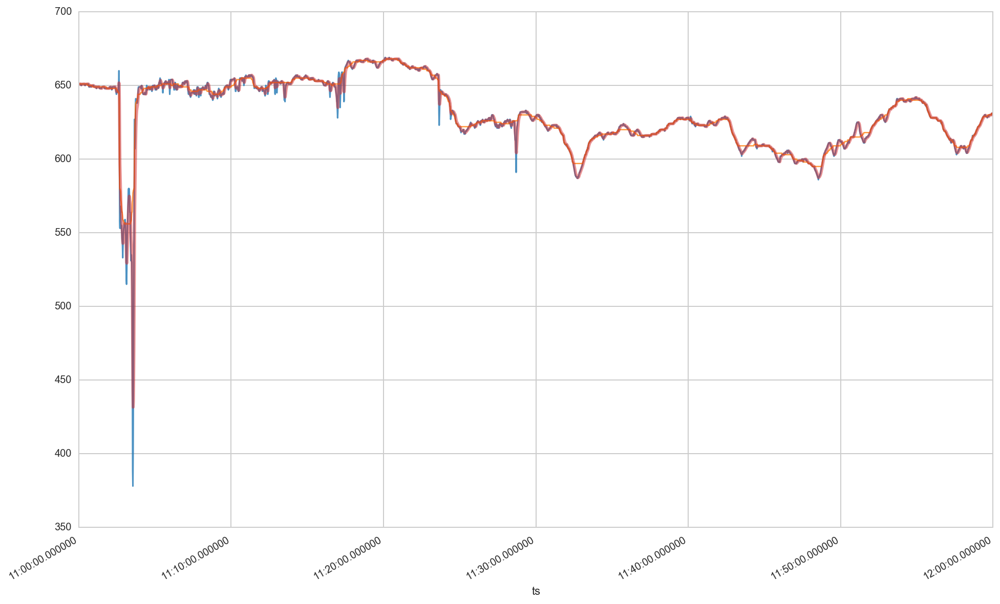

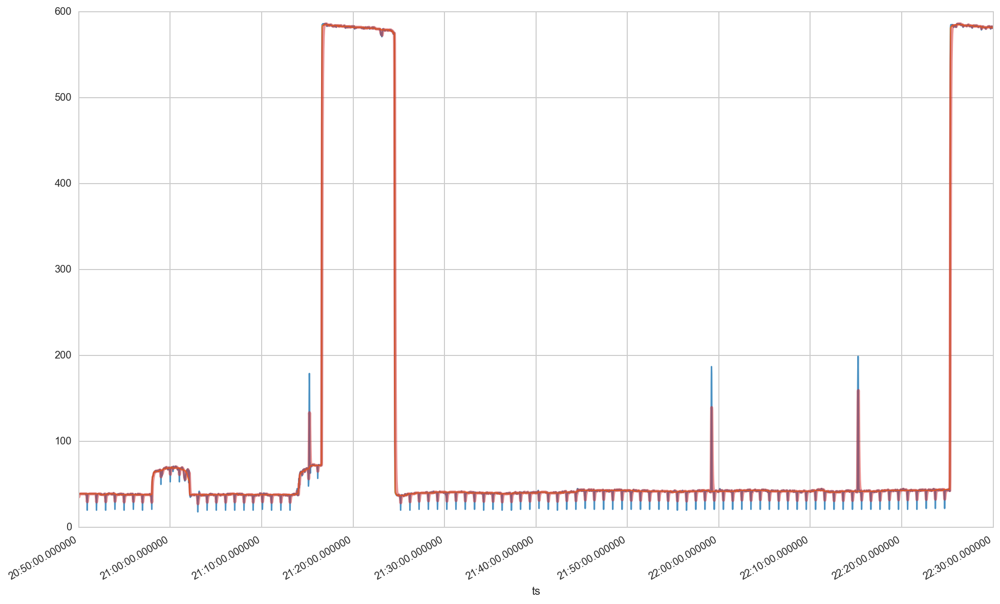

In [147]:
def plot_detalle_filtros(data_day, t0, tf):
    df = data_day.between_time(t0, tf)
    ewm = day.ewm(halflife=2).raw_ldr.mean()
    f, ax = plt.subplots(1, 1, figsize=FS)
    df.raw_ldr.plot(ax=ax, lw=1.5, alpha=.8, color=tableau20[0])
    df.median_filter.plot(ax=ax, lw=1.25, alpha=.8, color=tableau20[2])
    ewm.between_time(t0, tf).plot(ax=ax, lw=3, alpha=.5, color=tableau20[6])
    plt.show()
    

#t0, tf = '21:00', '22:30'
t0, tf = '11:00', '12:00'
plot_detalle_filtros(day, t0, tf)
t0, tf = '20:50', '22:30'
plot_detalle_filtros(day, t0, tf)

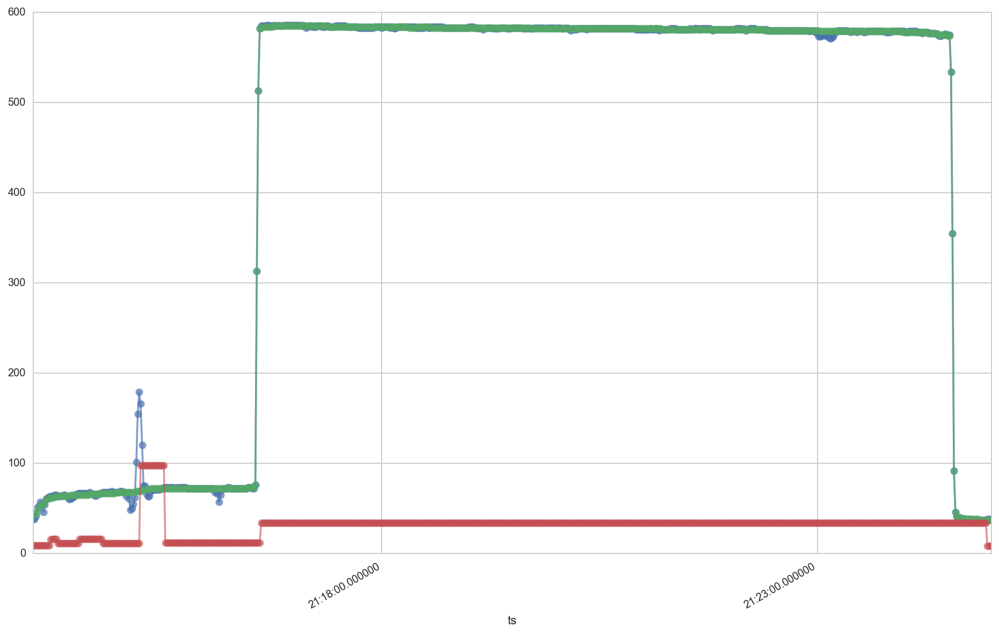

In [218]:
prueba = day.between_time('21:14', '21:25')
ax = prueba.raw_ldr.plot(figsize=FS, marker='o', alpha=.7)
prueba.median_filter.plot(ax=ax, marker='o', alpha=.6)
prueba.rms_err_m7.plot(ax=ax, marker='o', alpha=.6)

In [5]:
tic = time()

def plot_detalle_filtros(data_day, t0, tf):
    df = data_day.between_time(t0, tf)
    ewm = day.ewm(halflife=2).raw_ldr.mean()
    f, ax = plt.subplots(1, 1, figsize=FS)
    df.raw_ldr.plot(ax=ax, lw=1.5, alpha=.8, color=tableau20[0])
    df.median_filter.plot(ax=ax, lw=1.25, alpha=.8, color=tableau20[2])
    #ewm.between_time(t0, tf).plot(ax=ax, lw=3, alpha=.5, color=tableau20[6])
    df.steps.plot(ax=ax, lw=1, alpha=.7, color=tableau20[8])
    df.steps_max.plot(ax=ax, lw=1, alpha=.8, color=tableau20[10], marker='o')
    plt.show()


def _info_tiempos(cad):
    global tic
    toc = time()
    print_ok('--> {:35}\t OK\t [TOOK {:.3f} seconds]'.format(cad, toc - tic))
    tic = toc


@timeit('extrae_eventos_LDR', verbose=True)
def extrae_eventos_LDR(data_raw, kernel_size=75, threshold_step=10, roll_number=7):
    _info_tiempos('Iniciando desde...')
    print_info("IDENTIFICACIÓN POI's LDR.\n * {} raw points. De {:%d-%m-%y} a {:%d-%m-%y} ({:.1f} horas)"
               .format(len(data_raw), data_raw.index[0], data_raw.index[-1], len(data_raw) / 3600.))
    
    delta_rs = pd.Timedelta('5s')
    DELTA_MIN_PARA_CONSIDERACION_MAX_LOCAL = 20

    # Resampling 1s
    data_homog = pd.DataFrame(data_raw.ldr.resample('1s').mean().fillna(method='bfill', limit=5).fillna(-1))
    _info_tiempos('Resampling 1s')
    
    # Median filter
    data_homog['median_filter'] = medfilt(data_homog.ldr, kernel_size=[kernel_size])
    _info_tiempos('MedFilt')
    
    # mf_resampled = set_sun_times(mf_resampled, delta_rs, tz=TZ, lat_deg=LAT, long_deg=LONG, offset='10min')
    
    # Saltos en eventos
    mf_roller = data_homog.median_filter.rolling(roll_number, center=True)
    ind_mid = roll_number // 2
    
    data_homog['steps'] = mf_roller.apply(lambda x: (x[roll_number-1] + x[roll_number-2]) / 2 - (x[1] + x[0]) / 2).fillna(0)
    _info_tiempos('Steps calc')
    # Busca saltos max-min
    roll_steps = data_homog['steps'].rolling(roll_number, center=True)
    idx_up = data_homog[roll_steps.apply(lambda x: (np.argmax(x) == ind_mid) and (x[ind_mid] > threshold_step)).fillna(0) > 0].index
    idx_down = data_homog[roll_steps.apply(lambda x: (np.argmin(x) == ind_mid) and (x[ind_mid] < -threshold_step)).fillna(0) > 0].index
    _info_tiempos('Steps UP / DOWN Filter')

    #cols_eventos = ['steps', 'median_filter', 'rms_err_min301']
    cols_eventos = ['steps', 'median_filter']
    subidas = data_homog.loc[idx_up, cols_eventos].copy()
    bajadas = data_homog.loc[idx_down, cols_eventos].copy()
    _info_tiempos('Eventos')
    
    mf_slope_roll = data_homog.median_filter.diff().rolling(roll_number, center=True).mean()
    mf_roll = mf_roller.median()

    offsets_mf = range(-11, 12, 3)
    for d in offsets_mf:
        subidas['slope_roll_{}'.format(d)] = mf_slope_roll.shift(d).loc[idx_up]
        bajadas['slope_roll_{}'.format(d)] = mf_slope_roll.shift(d).loc[idx_down]
        subidas['mf_roll_{}'.format(d)] = mf_roll.shift(d).loc[idx_up]
        bajadas['mf_roll_{}'.format(d)] = mf_roll.shift(d).loc[idx_down]

    assert(len(subidas.index.intersection(bajadas.index)) == 0)
    eventos = pd.concat([subidas, bajadas], axis=0).sort_index()
    eventos['es_subida'] = eventos['steps'] > 0
    _info_tiempos('Eventos slope & process')
    
    # Altitud / azimut solar
    eventos = eventos.join(sun_position(eventos.index, latitude_deg=LAT, longitude_deg=LONG, elevation=ELEV_M, 
                           delta_n_calc=1, south_orient=True).round(1))
    _info_tiempos('Eventos SUN position')
    # INTERVALOS
    #day.loc[eventos.index, 'interv'] = 1
    #day.interv = day.interv.fillna(0).cumsum()
    #day.groupby('interv').median_filter.count()

    print(eventos.shape)
    return eventos, data_homog
    #print_red(eventos.head(5))
    
    
str_day = '2016-09-01'
eventos, data = extrae_eventos_LDR(LDR.loc[str_day:str_day], threshold_step=10, roll_number=7)
#print_cyan(data.head())
eventos.head()

--> Iniciando desde...                 	 OK	 [TOOK 0.230 seconds]
IDENTIFICACIÓN POI's LDR.
 * 85705 raw points. De 01-09-16 a 01-09-16 (23.8 horas)
--> Resampling 1s                      	 OK	 [TOOK 0.041 seconds]
--> MedFilt                            	 OK	 [TOOK 0.185 seconds]
--> Steps calc                         	 OK	 [TOOK 0.121 seconds]
--> Steps UP / DOWN Filter             	 OK	 [TOOK 0.248 seconds]
--> Eventos                            	 OK	 [TOOK 0.002 seconds]
--> Eventos slope & process            	 OK	 [TOOK 0.082 seconds]
sun_position TOOK: 0.001 s
--> Eventos SUN position               	 OK	 [TOOK 0.003 seconds]
(55, 21)
extrae_eventos_LDR TOOK: 0.682 s


,steps,median_filter,slope_roll_-11,mf_roll_-11,slope_roll_-8,mf_roll_-8,slope_roll_-5,mf_roll_-5,slope_roll_-2,mf_roll_-2,...,mf_roll_1,slope_roll_4,mf_roll_4,slope_roll_7,mf_roll_7,slope_roll_10,mf_roll_10,es_subida,altitude,azimuth
ts,,,,,,,,,,,,,,,,,,,,,
2016-09-01 12:51:03+02:00,-14.0,411.0,-6.428571,367.0,-4.857143,385.0,-3.142857,396.0,-3.000000,404.0,...,414.0,-1.000000,420.0,-0.285714,421.0,-0.285714,422.0,False,55.4,-32.7
2016-09-01 12:51:19+02:00,-70.5,328.0,0.000000,283.0,0.000000,283.0,-2.285714,283.0,-9.428571,283.0,...,345.0,-5.714286,360.0,-5.142857,384.0,-2.857143,395.0,False,55.4,-32.6
2016-09-01 12:52:12+02:00,12.0,302.0,8.571429,341.0,4.571429,317.0,2.000000,313.0,2.142857,309.0,...,301.0,1.571429,295.0,1.000000,291.0,1.142857,289.0,True,55.5,-32.2
2016-09-01 12:52:24+02:00,50.0,352.0,2.000000,396.0,2.000000,390.0,3.714286,383.0,7.142857,376.0,...,341.0,4.571429,317.0,2.000000,313.0,2.142857,309.0,True,55.5,-32.2
2016-09-01 12:53:33+02:00,-19.5,387.0,0.000000,371.0,0.000000,371.0,-2.285714,371.0,-2.714286,374.0,...,387.0,-2.428571,397.0,-1.000000,404.0,0.000000,404.0,False,55.6,-31.7


In [6]:
eventos_tot, data_tot = extrae_eventos_LDR(LDR, threshold_step=10, roll_number=7)
eventos_tot.count()

--> Iniciando desde...                 	 OK	 [TOOK 3.842 seconds]
IDENTIFICACIÓN POI's LDR.
 * 2725278 raw points. De 12-08-16 a 14-09-16 (757.0 horas)
--> Resampling 1s                      	 OK	 [TOOK 0.202 seconds]
--> MedFilt                            	 OK	 [TOOK 6.395 seconds]
--> Steps calc                         	 OK	 [TOOK 3.636 seconds]
--> Steps UP / DOWN Filter             	 OK	 [TOOK 8.059 seconds]
--> Eventos                            	 OK	 [TOOK 0.002 seconds]
--> Eventos slope & process            	 OK	 [TOOK 2.377 seconds]
sun_position TOOK: 0.053 s
--> Eventos SUN position               	 OK	 [TOOK 0.055 seconds]
(1381, 21)
extrae_eventos_LDR TOOK: 20.749 s


steps             1381
median_filter     1381
slope_roll_-11    1381
mf_roll_-11       1381
slope_roll_-8     1381
mf_roll_-8        1381
slope_roll_-5     1381
mf_roll_-5        1381
slope_roll_-2     1381
mf_roll_-2        1381
slope_roll_1      1381
mf_roll_1         1381
slope_roll_4      1381
mf_roll_4         1381
slope_roll_7      1381
mf_roll_7         1381
slope_roll_10     1381
mf_roll_10        1381
es_subida         1381
altitude          1381
azimuth           1381
dtype: int64

In [32]:
sns.pairplot(eventos_tot, hue='es_subida')

/Users/uge/anaconda/envs/py35/lib/python3.5/site-packages/statsmodels/nonparametric/kdetools.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  y = X[:m/2+1] + np.r_[0,X[m/2+1:],0]*1j


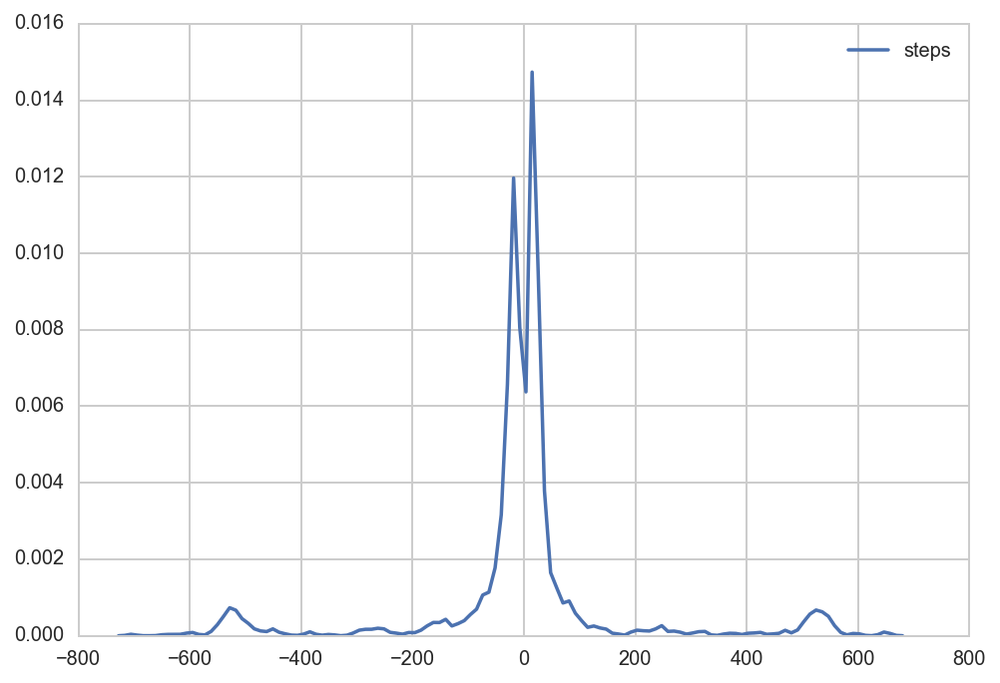

In [35]:
sns.kdeplot(eventos_tot.steps.round().astype(int))

In [10]:
eventos_tot.to_hdf('eventos_LDR.h5', 'eventos')
data_tot.to_hdf('data_LDR.h5', 'data')

In [22]:
eventos_tot.columns.sort_values()

Index(['altitude', 'azimuth', 'es_subida', 'median_filter', 'mf_roll_-11', 'mf_roll_-2', 'mf_roll_-5', 'mf_roll_-8', 'mf_roll_1', 'mf_roll_10', 'mf_roll_4', 'mf_roll_7',
       'slope_roll_-11', 'slope_roll_-2', 'slope_roll_-5', 'slope_roll_-8', 'slope_roll_1', 'slope_roll_10', 'slope_roll_4', 'slope_roll_7', 'steps'],
      dtype='object')

   index           0           1          2           3             4             5           6           7  \
0      0   31.300971  263.640777  22.796117   21.972816  3.686287e-18 -6.938894e-17  285.349515  277.650485   
1      1   32.539604  571.188119  44.441584   12.432673  3.686287e-18 -6.938894e-17  592.049505  584.891089   
2      2  500.232143  379.803571  -0.923214  102.944643  1.301043e-18  1.785714e-02  576.464286  565.196429   
3      3   54.757576   79.833333  -1.677273   90.460606  1.515152e-02  2.424242e-01  107.681818  102.106061   
4      4   42.564171  456.064171  44.259358   -6.694652  4.987330e-18  1.110223e-16  484.245989  474.481283   
5      5   25.300000  350.466667  38.937222   10.527222  4.770490e-18  1.040834e-16  371.555556  361.155556   
6      6  542.178571   34.214286  31.907143   39.007143  0.000000e+00  7.142857e-01  551.500000  549.857143   

            8           9          10         11         12         13         14        15  items  
0  254.776

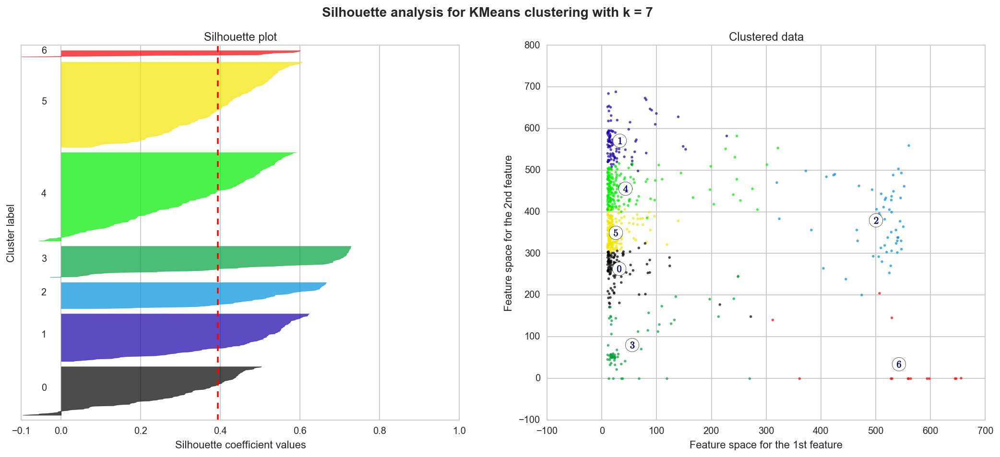

silhouette_analysis TOOK: 1.182 s


In [75]:
from datacharm.datafuncs import trimedia_TM, kmeans_1d, kmeans_md, clustering_pca_2d, silhouette_analysis, KMeans, PCA

eventos_tot = pd.read_hdf('eventos_LDR.h5', 'eventos')
eventos_tot.loc[eventos_tot.altitude < -5, 'altitude'] = -5
eventos_tot.loc[eventos_tot.altitude < -5, 'azimuth'] = -180

eventos_tot['es_fin'] = False
eventos_tot['es_init'] = False
eventos_tot.loc[eventos_tot.mf_roll_10 == -1, 'es_fin'] = True
eventos_tot.loc[eventos_tot['mf_roll_-11'] == -1, 'es_init'] = True

cols_cluster = ['steps', 'median_filter', 'altitude', 'azimuth', 'es_init', 'es_fin',
                'mf_roll_-8', 'mf_roll_-2', 'mf_roll_1', 'mf_roll_4', 'mf_roll_7',
                'slope_roll_-5', 'slope_roll_-2', 'slope_roll_1', 'slope_roll_4', 'slope_roll_7']
# 'es_subida', 

#centers_km_c, labels_km_c, X_km_c, km_c, df_cl_c = kmeans_1d(pois_labeled, 'step', 7) #, func_preprocess=np.sqrt)
#silhouette_analysis(centers_km_c, labels_km_c, X_km_c)

k = 7
centers_km_c, labels_km_c, X_km_c, km_c = kmeans_md(eventos_tot[eventos_tot.es_subida], cols_cluster, k, sort_labels=False)
silhouette_analysis(centers_km_c, labels_km_c, X_km_c)

explained variance ratio (first two components): [ 0.69351973  0.26101271]


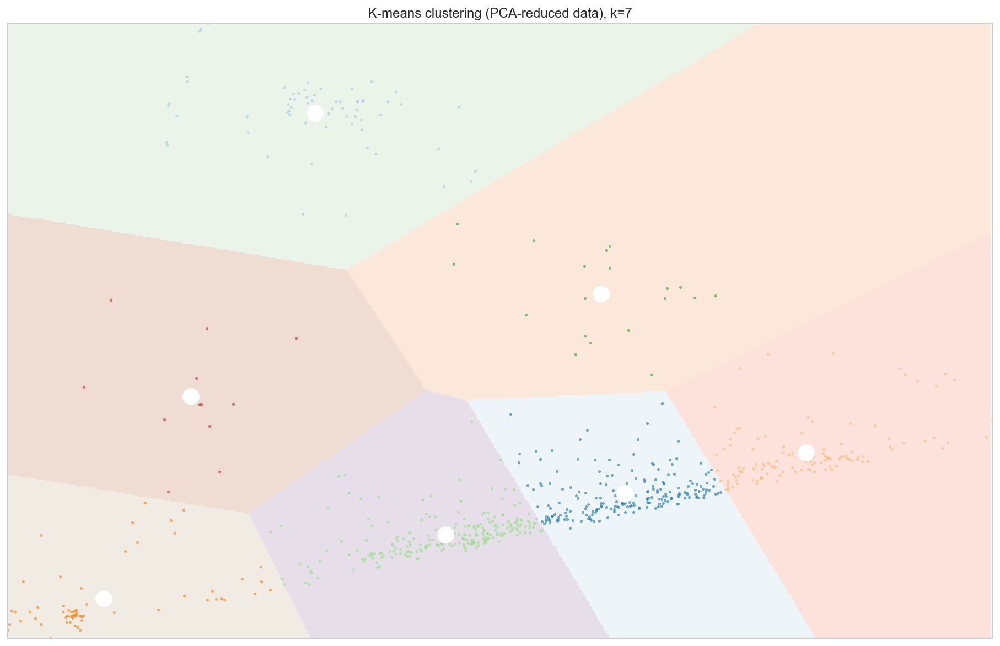

clustering_pca_lda TOOK: 0.942 s


KMeans(copy_x=True, init='k-means++', max_iter=300, n_clusters=7, n_init=10,
    n_jobs=1, precompute_distances='auto', random_state=None, tol=0.0001,
    verbose=0)

In [76]:
X = eventos_tot.loc[eventos_tot.es_subida, cols_cluster].astype(float).values
k = 7
kmeans_pca = clustering_pca_2d(X, k, whiten=True)
kmeans_pca

explained variance ratio (first two components): [ 0.7003332   0.26762294]


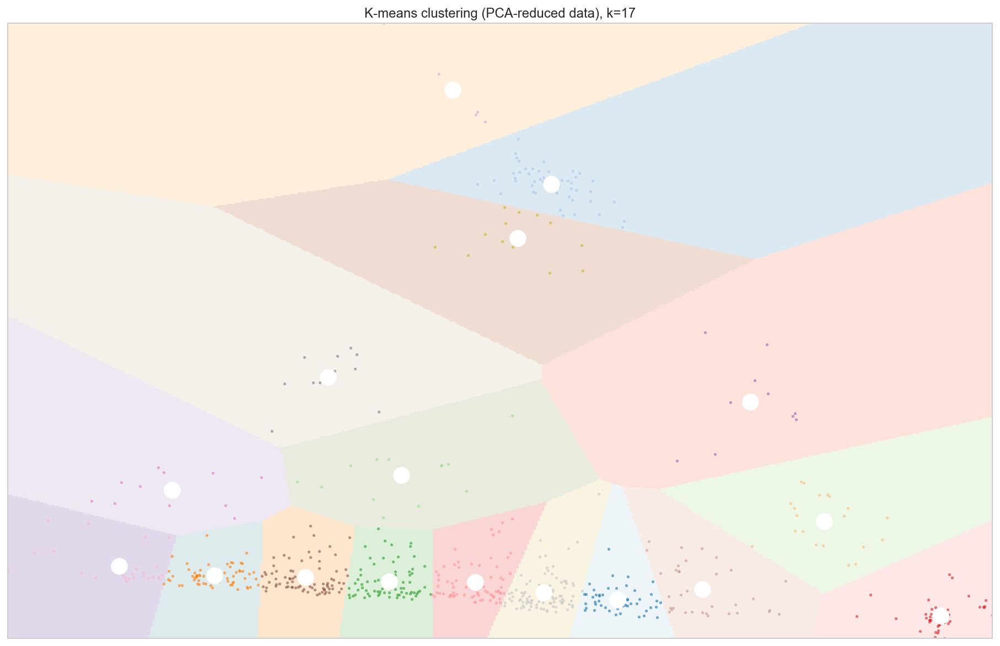

clustering_pca_lda TOOK: 1.013 s


KMeans(copy_x=True, init='k-means++', max_iter=300, n_clusters=17, n_init=10,
    n_jobs=1, precompute_distances='auto', random_state=None, tol=0.0001,
    verbose=0)

In [77]:
X = eventos_tot.loc[~eventos_tot.es_subida, cols_cluster].astype(float).values
k = 17
kmeans_pca_bajadas = clustering_pca_2d(X, k, whiten=True)
kmeans_pca_bajadas

In [78]:
subidas = eventos_tot[eventos_tot.es_subida].copy()
subidas['km_pca'] = kmeans_pca.labels_
subidas.km_pca.value_counts()

5    230
0    202
3    117
1     65
2     62
4     19
6     12
Name: km_pca, dtype: int64

 ==> 2016-08-15 21:17:49+02:00
2016-08-15
 ==> 2016-08-19 22:11:20+02:00
 ==> 2016-08-20 21:52:08+02:00
 ==> 2016-08-23 21:26:45+02:00
 ==> 2016-08-26 20:20:18+02:00
 ==> 2016-09-02 23:45:42+02:00
 ==> 2016-09-06 20:36:01+02:00
 ==> 2016-09-12 19:46:22+02:00


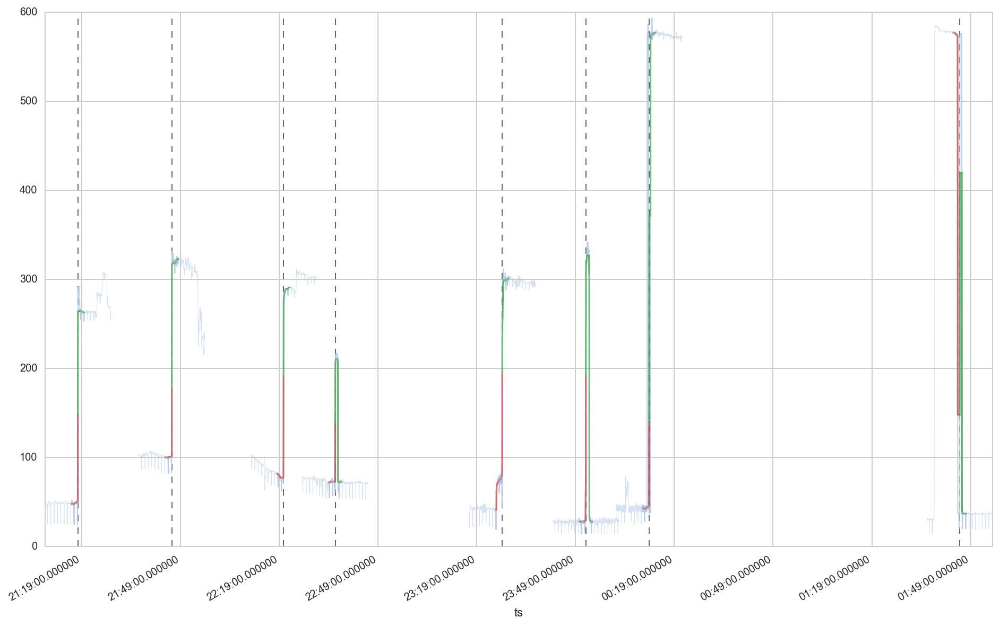

,steps,median_filter,slope_roll_-11,mf_roll_-11,slope_roll_-8,mf_roll_-8,slope_roll_-5,mf_roll_-5,slope_roll_-2,mf_roll_-2,...,slope_roll_7,mf_roll_7,slope_roll_10,mf_roll_10,es_subida,altitude,azimuth,es_fin,es_init,km_pca
ts,,,,,,,,,,,,,,,,,,,,,
2016-08-15 21:17:49+02:00,213.0,148.0,0.000000,264.0,0.000000,264.0,3.571429,264.0,30.428571,264.0,...,0.142857,50.0,0.000000,50.0,True,-3.3,111.7,False,False,6
2016-08-19 22:11:20+02:00,312.0,140.0,0.000000,371.0,0.000000,371.0,14.285714,371.0,45.857143,350.0,...,0.428571,45.0,0.142857,45.0,True,-5.0,120.0,False,False,6
2016-08-20 21:52:08+02:00,241.0,191.0,0.857143,318.0,0.714286,317.0,6.000000,315.0,34.714286,308.0,...,4.571429,32.0,0.571429,29.0,True,-5.0,116.4,False,False,6
2016-08-23 21:26:45+02:00,135.0,196.0,5.714286,276.0,3.285714,266.0,8.428571,253.0,20.142857,226.0,...,0.285714,80.0,0.142857,79.0,True,-5.0,111.5,False,False,6
2016-08-26 20:20:18+02:00,197.0,190.0,0.285714,282.0,0.428571,281.0,4.000000,279.0,28.714286,273.0,...,0.000000,77.0,0.000000,77.0,True,3.5,100.2,False,False,6
2016-09-02 23:45:42+02:00,272.0,148.0,0.000000,420.0,0.000000,420.0,30.142857,420.0,38.857143,420.0,...,0.000000,148.0,0.000000,148.0,True,-5.0,137.7,False,False,6
2016-09-06 20:36:01+02:00,132.5,140.0,0.000000,211.0,0.428571,211.0,3.285714,209.0,19.285714,206.0,...,0.142857,73.0,0.000000,73.0,True,-1.7,100.1,False,False,6
2016-09-12 19:46:22+02:00,215.5,177.0,0.142857,317.0,0.000000,317.0,6.428571,317.0,30.857143,316.0,...,0.000000,101.0,0.000000,101.0,True,5.1,90.9,False,False,6


In [97]:
pd.set_option('display.width', 120)


def plot_events_on_day(eventos, data_tot):
    delta = pd.Timedelta('2min')
    delta_big = pd.Timedelta('10min')
    ax, day_plot = None, None
    for t, row in eventos.iterrows():
        print_secc(str(t))
        roundings = data_tot.loc[t-delta:t+delta].copy()
        roundings_big = data_tot.loc[t-delta_big:t+delta_big].copy()
        if not roundings.empty:
            if ax is None:
                day_plot = t.date()
                print_red(day_plot)
            else:
                t = dt.datetime.combine(day_plot, t.time())
                new_index = pd.DatetimeIndex([dt.datetime.combine(day_plot, t) for t in roundings.index.time])
                new_index_big = pd.DatetimeIndex([dt.datetime.combine(day_plot, t) for t in roundings_big.index.time])
                roundings.index = new_index
                roundings_big.index = new_index_big
            if ax is None:
                ax = roundings['ldr'].plot(figsize=FS, lw=1, alpha=.8, color=tableau20[1])
            else:
                roundings['ldr'].plot(ax=ax, lw=1, alpha=.8, color=tableau20[1])
            ini = roundings['median_filter'].loc[:t]
            fin = roundings['median_filter'].loc[t:]
            if not ini.empty:
                ini.plot(ax=ax, lw=1.5, alpha=.8, color=tableau20[6])
            else:
                print_magenta('No hay INIT')
            if not fin.empty:
                fin.plot(ax=ax, lw=1.5, alpha=.8, color=tableau20[4])
            else:
                print_red('No hay FIN')
            ax.vlines([t], 0, 800, lw=1, linestyle='--', alpha=.6)
            roundings_big.ldr.plot(ax=ax, lw=.5, alpha=.5, color=tableau20[1])
    plt.show()


subset_subidas = subidas[(subidas.km_pca == 6) & ~subidas.es_fin]
plot_events_on_day(subset_subidas, data_tot)
subset_subidas.head(10)

5    230
0    202
3    117
1     65
2     62
4     19
6     12
Name: km_pca, dtype: int64
 ==> 2016-08-12 11:43:49+02:00
2016-08-12
 ==> 2016-08-12 12:46:57+02:00
 ==> 2016-08-12 12:47:20+02:00
 ==> 2016-08-12 12:51:36+02:00
 ==> 2016-08-12 13:04:05+02:00
 ==> 2016-08-12 14:20:57+02:00
 ==> 2016-08-12 14:21:10+02:00
 ==> 2016-08-12 14:30:12+02:00
 ==> 2016-08-12 14:30:19+02:00
 ==> 2016-08-12 14:36:05+02:00
 ==> 2016-08-12 14:36:15+02:00
 ==> 2016-08-12 14:41:44+02:00
 ==> 2016-08-12 14:42:04+02:00
 ==> 2016-08-12 14:47:59+02:00
 ==> 2016-08-12 14:50:33+02:00
 ==> 2016-08-12 14:52:13+02:00
 ==> 2016-08-12 14:52:27+02:00
 ==> 2016-08-12 15:42:43+02:00
 ==> 2016-08-12 15:51:02+02:00
 ==> 2016-08-12 16:32:15+02:00
 ==> 2016-08-13 19:49:53+02:00
 ==> 2016-08-13 19:50:08+02:00
 ==> 2016-08-14 12:02:25+02:00
 ==> 2016-08-14 14:33:20+02:00
 ==> 2016-08-14 14:52:57+02:00
 ==> 2016-08-14 22:21:30+02:00
 ==> 2016-08-15 10:13:32+02:00
 ==> 2016-08-15 10:14:54+02:00
 ==> 2016-08-15 15:35:44+02:00


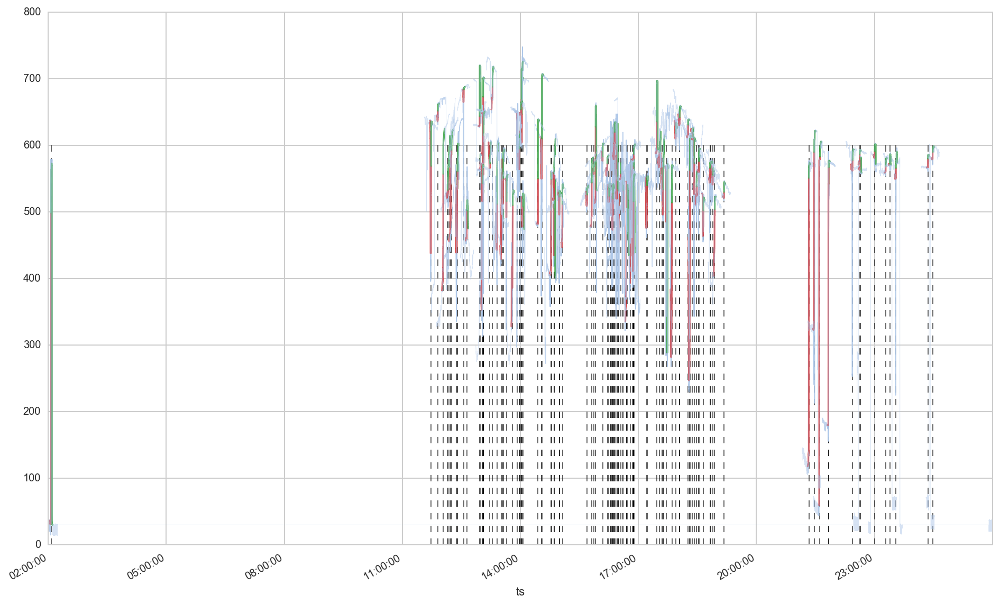

,steps,median_filter,slope_roll_-11,mf_roll_-11,slope_roll_-8,mf_roll_-8,slope_roll_-5,mf_roll_-5,slope_roll_-2,mf_roll_-2,...,slope_roll_7,mf_roll_7,slope_roll_10,mf_roll_10,es_subida,altitude,azimuth,es_fin,es_init,km_pca
ts,,,,,,,,,,,,,,,,,,,,,
2016-08-12 11:43:49+02:00,61.5,569.0,1.285714,630.0,3.428571,627.0,6.571429,611.0,10.285714,592.0,...,4.857143,525.0,12.428571,513.0,True,50.3,-63.2,False,False,3
2016-08-12 12:46:57+02:00,17.0,503.0,1.571429,529.0,2.142857,525.0,3.000000,516.0,2.714286,509.0,...,2.571429,482.0,2.285714,473.0,True,60.1,-42.5,False,False,3
2016-08-12 12:47:20+02:00,16.5,549.0,0.000000,559.0,0.000000,559.0,1.000000,559.0,2.571429,556.0,...,1.428571,536.0,1.428571,532.0,True,60.2,-42.4,False,False,3
2016-08-12 12:51:36+02:00,49.0,505.0,0.857143,538.0,0.714286,535.0,2.714286,534.0,7.142857,524.0,...,4.714286,456.0,3.000000,440.0,True,60.8,-40.6,False,False,3
2016-08-12 13:04:05+02:00,55.5,512.0,0.142857,541.0,0.285714,540.0,2.428571,539.0,7.714286,533.0,...,1.000000,464.0,0.285714,463.0,True,62.2,-35.1,False,False,3
2016-08-12 14:20:57+02:00,20.0,540.0,1.857143,560.0,1.000000,557.0,2.142857,554.0,3.571429,545.0,...,6.285714,514.0,6.571429,493.0,True,66.0,7.5,False,False,3
2016-08-12 14:21:10+02:00,16.5,567.0,0.428571,583.0,0.857143,582.0,1.857143,581.0,3.000000,575.0,...,1.857143,556.0,3.142857,550.0,True,66.0,7.6,False,False,3
2016-08-12 14:30:12+02:00,18.0,508.0,1.857143,542.0,3.571429,537.0,3.428571,519.0,2.857143,517.0,...,0.428571,496.0,0.285714,495.0,True,65.6,12.9,False,False,3
2016-08-12 14:30:19+02:00,23.5,529.0,0.000000,542.0,0.000000,542.0,0.714286,542.0,3.285714,541.0,...,2.714286,508.0,1.714286,499.0,True,65.6,12.9,False,False,3


In [103]:
print_yellowb(subidas.km_pca.value_counts())
subset_subidas = subidas[(subidas.km_pca == 3)]  # & ~subidas.es_fin
plot_events_on_day(subset_subidas, data_tot)
subset_subidas.head(10)

Estimated number of clusters: 8
Silhouette Coefficient: 0.224
                 0   1  -1   2   3   4   6   5   7
Label members  558  48  29   9   8   7   6   5   4


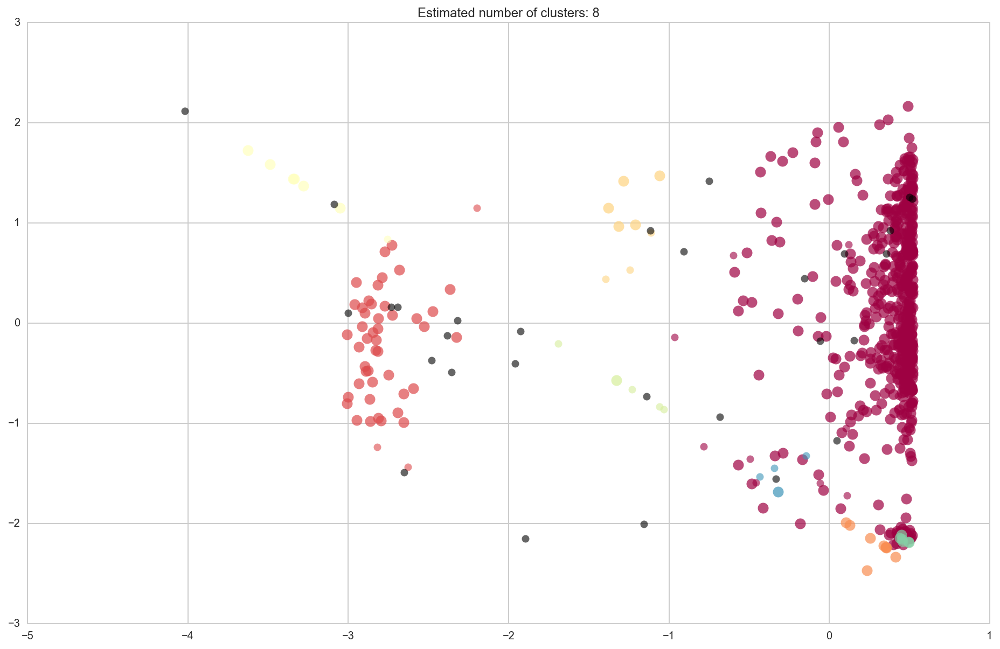

In [152]:
# DBSCAN Clustering
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.datasets.samples_generator import make_blobs
from sklearn.preprocessing import StandardScaler



X_dbscan = StandardScaler().fit_transform(X)
#X_dbscan = X

# Compute DBSCAN
db = DBSCAN(eps=1.6, min_samples=5).fit(X_dbscan)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print_magenta('Estimated number of clusters: %d' % n_clusters_)
#print("Homogeneity: %0.3f" % metrics.homogeneity_score(labels_true, labels))
#print("Completeness: %0.3f" % metrics.completeness_score(labels_true, labels))
#print("V-measure: %0.3f" % metrics.v_measure_score(labels_true, labels))
#print("Adjusted Rand Index: %0.3f"
#      % metrics.adjusted_rand_score(labels_true, labels))
#print("Adjusted Mutual Information: %0.3f"
#      % metrics.adjusted_mutual_info_score(labels_true, labels))
print_info("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_dbscan, labels))
print_cyan(pd.DataFrame(pd.Series(labels).value_counts().rename('Label members')).T)

# Plot result
fig, ax = plt.subplots(1, 1, figsize=FS)
# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_labels)))
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = 'k'

    class_member_mask = (labels == k)

    xy = X_dbscan[class_member_mask & core_samples_mask]
    ax.plot(xy[:, 0], xy[:, 1], 'o', color=col, lw=0, markersize=10, alpha=.7)

    xy = X_dbscan[class_member_mask & ~core_samples_mask]
    ax.plot(xy[:, 0], xy[:, 1], 'o', color=col, lw=0, markersize=7, alpha=.6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

Estimated number of clusters: 9
Silhouette Coefficient: 0.435


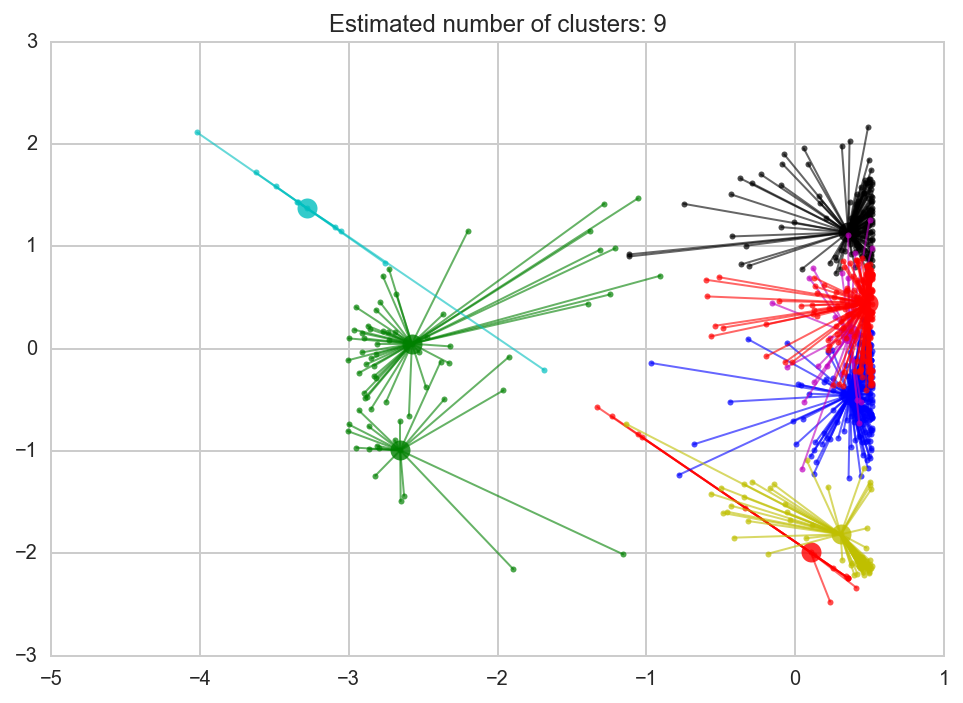

In [316]:
from sklearn.cluster import AffinityPropagation
from sklearn import metrics
from sklearn.datasets.samples_generator import make_blobs


# Compute Affinity Propagation
X = X_dbscan
#af = AffinityPropagation(preference=-50).fit(X)
af = AffinityPropagation(preference=-250).fit(X)
cluster_centers_indices = af.cluster_centers_indices_
labels = af.labels_

n_clusters_ = len(cluster_centers_indices)

print('Estimated number of clusters: %d' % n_clusters_)
#print("Homogeneity: %0.3f" % metrics.homogeneity_score(labels_true, labels))
#print("Completeness: %0.3f" % metrics.completeness_score(labels_true, labels))
#print("V-measure: %0.3f" % metrics.v_measure_score(labels_true, labels))
#print("Adjusted Rand Index: %0.3f" % metrics.adjusted_rand_score(labels_true, labels))
#print("Adjusted Mutual Information: %0.3f" % metrics.adjusted_mutual_info_score(labels_true, labels))
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(X, labels, metric='sqeuclidean'))


# Plot result
from itertools import cycle
colors = cycle('rgbkymc')
for k, col in zip(range(n_clusters_), colors):
    class_members = labels == k
    cluster_center = X[cluster_centers_indices[k]]
    plt.plot(X[class_members, 0], X[class_members, 1], 'o', color=col, lw=0, markersize=3, alpha=.7)
    plt.plot(cluster_center[0], cluster_center[1], 'o', color=col, lw=0, markersize=10, alpha=.8)
    for x in X[class_members]:
        plt.plot([cluster_center[0], x[0]], [cluster_center[1], x[1]], col, lw=1, alpha=.6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

In [247]:
data_tot.head()

,ldr,median_filter,steps
ts,,,
2016-08-12 10:46:25+02:00,661.0,0.0,0.0
2016-08-12 10:46:26+02:00,660.0,0.0,0.0
2016-08-12 10:46:27+02:00,660.0,0.0,0.0
2016-08-12 10:46:28+02:00,659.0,0.0,0.0
2016-08-12 10:46:29+02:00,658.0,0.0,0.0


(707, 63)


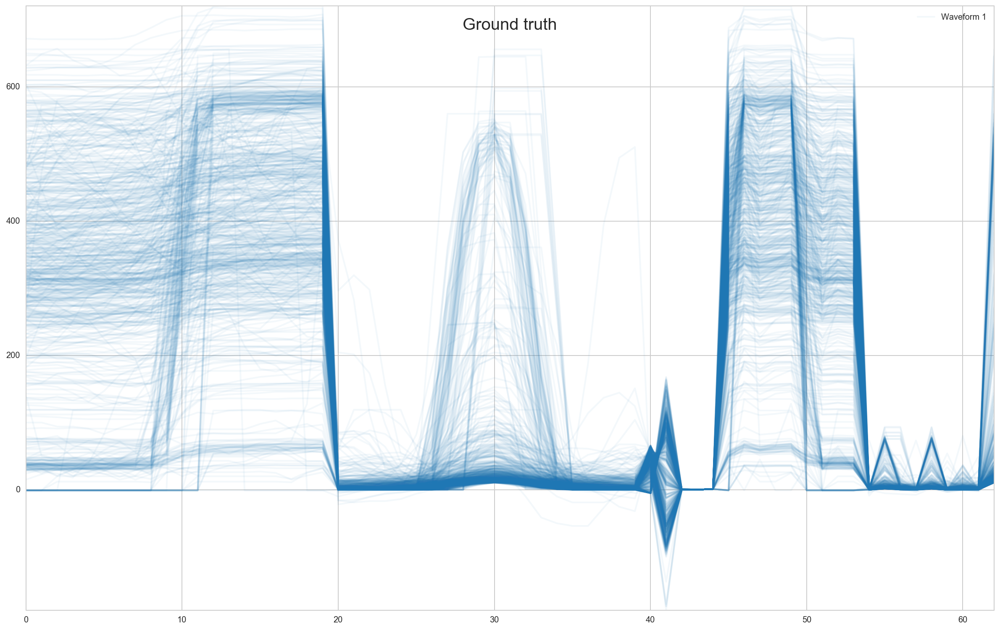

In [260]:
# AgglomerativeClustering

# Feature as raw as waveform around event:
eventos_feat = eventos_tot[eventos_tot.es_subida]
features_around = 10
X_ag = np.zeros((len(eventos_feat), 4 * features_around + eventos_feat.shape[1]))
print_red(X_ag.shape)
for i, (t, row) in enumerate(eventos_feat.iterrows()):
    iloc = data_tot.index.get_loc(t)
    xi_1 = data_tot.iloc[iloc - features_around:iloc + features_around].values[:, 0]
    xi_2 = data_tot.iloc[iloc - features_around:iloc + features_around].values[:, 2]
    xi_3 = row.sort_index().values
    X_ag[i, :] = np.concatenate([xi_1, xi_2, xi_3])
    

# Plot the ground-truth labelling
plt.figure(figsize=FS)
plt.axes([0, 0, 1, 1])
lines = plt.plot(X_ag.T, c=tableau20[0], alpha=.05, lw=2)
lines[0].set_label(labels[0])
plt.legend(loc='best')

plt.axis('tight')
plt.suptitle("Ground truth", size=20);


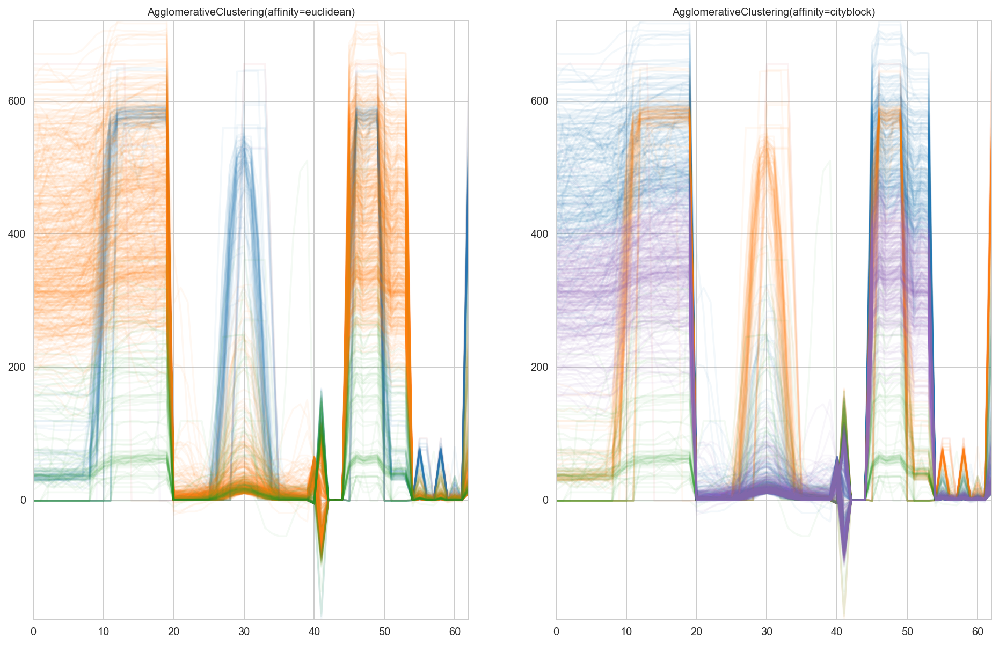

In [262]:
# Plot the distances
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import pairwise_distances


"""def agglomerative_clustering(X, n_clusters=3, linkage='average', affinity='cityblock'):
    model = AgglomerativeClustering(n_clusters=n_clusters, linkage=linkage, affinity=metric)
    model.fit(X_ag)
    return model"""
    
#n_clusters = 9
n_clusters = 5
#metrics = ["euclidean", "cityblock", "cosine"]  #"manhattan", 
linkage = "average"
metrics = ["euclidean", "cityblock"]  #"manhattan", 
#linkage = "ward"
#linkage = "complete"
# Plot clustering results
f, axes = plt.subplots(1, len(metrics), figsize=FS)
for index, (metric, ax) in enumerate(zip(metrics, axes)):
    model = AgglomerativeClustering(n_clusters=n_clusters, linkage=linkage, affinity=metric)
    model.fit(X_ag)
    for l, c in zip(np.arange(model.n_clusters), tableau20[::2]):
        ax.plot(X_ag[model.labels_ == l].T, c=c, alpha=.05)
    ax.axis('tight')
    ax.set_title("AgglomerativeClustering(affinity=%s)" % metric, size=10)
plt.show()

In [315]:
eventos_feat = eventos_feat.copy()
eventos_feat['ag_cluster'] = model.labels_
eventos_feat.groupby('ag_cluster').steps.count()

eventos_feat[eventos_feat.ag_cluster == 1].head()

,steps,median_filter,slope_roll_-11,mf_roll_-11,slope_roll_-8,mf_roll_-8,slope_roll_-5,mf_roll_-5,slope_roll_-2,mf_roll_-2,...,slope_roll_7,mf_roll_7,slope_roll_10,mf_roll_10,es_subida,altitude,azimuth,es_fin,es_init,ag_cluster
ts,,,,,,,,,,,,,,,,,,,,,
2016-08-13 00:10:08+02:00,510.5,378.0,0.857143,598.0,1.571429,594.0,7.285714,589.0,73.714286,578.0,...,4.428571,63.0,4.285714,46.0,True,-5.0,146.6,False,False,1
2016-08-13 19:49:44+02:00,319.5,470.0,2.428571,541.0,2.428571,534.0,8.714286,525.0,49.285714,480.0,...,0.000000,180.0,0.000000,180.0,True,12.5,98.6,False,False,1
2016-08-13 22:16:32+02:00,560.0,-1.0,0.428571,561.0,0.285714,560.0,80.142857,559.0,80.000000,559.0,...,0.000000,-1.0,0.000000,-1.0,True,-5.0,122.1,True,False,1
2016-08-13 22:20:38+02:00,564.0,-1.0,0.000000,563.0,0.000000,563.0,0.142857,563.0,80.571429,563.0,...,0.000000,-1.0,0.000000,-1.0,True,-5.0,122.8,True,False,1
2016-08-13 23:39:12+02:00,532.5,449.0,0.285714,574.0,0.142857,573.0,1.428571,573.0,76.142857,571.0,...,0.000000,38.0,0.000000,38.0,True,-5.0,139.0,False,False,1


In [17]:
import ephem

here = ephem.Observer()
here.lat = str(LAT)
here.lon = str(LONG)
here.elevation = ELEV_M

ephem.cities.lookup('Villena, Spain'), ephem.cities.lookup('Alicante, Spain'), here

(<ephem.Observer date='2016/9/20 11:12:33' epoch='2000/1/1 12:00:00' lon='-0:51:40.4' lat='38:37:54.6' elevation=0.0m horizon=0:00:00.0 temp=15.0C pressure=1010.0mBar>,
 <ephem.Observer date='2016/9/20 11:12:33' epoch='2000/1/1 12:00:00' lon='-0:29:26.5' lat='38:20:45.6' elevation=0.0m horizon=0:00:00.0 temp=15.0C pressure=1010.0mBar>,
 <ephem.Observer date='2016/9/20 11:12:33' epoch='2000/1/1 12:00:00' lon='-0:51:59.0' lat='38:37:53.3' elevation=500.0m horizon=0:00:00.0 temp=15.0C pressure=1010.0mBar>)

In [73]:
eventos_tot[eventos_tot.mf_roll_10 == -1].describe()
eventos_tot[eventos_tot['mf_roll_-11'] == -1].describe()


,steps,median_filter,slope_roll_-11,mf_roll_-11,slope_roll_-8,mf_roll_-8,slope_roll_-5,mf_roll_-5,slope_roll_-2,mf_roll_-2,slope_roll_1,mf_roll_1,slope_roll_4,mf_roll_4,slope_roll_7,mf_roll_7,slope_roll_10,mf_roll_10,altitude,azimuth
count,25.000000,25.000000,25.0,25.0,25.000000,25.0,25.000000,25.0,25.000000,25.00,25.000000,25.000000,25.000000,25.000000,2.500000e+01,25.000000,25.000000,25.000000,25.000000,25.000000
mean,-294.240000,292.640000,0.0,-1.0,-0.308571,-1.0,-41.891429,-1.0,-42.331429,0.84,-41.977143,294.800000,-0.005714,295.280000,1.776357e-17,295.040000,-0.177143,295.280000,18.180000,73.336000
std,253.437908,253.435048,0.0,0.0,1.542857,0.0,36.199637,0.0,35.848622,9.20,36.279988,251.311228,0.530498,251.127876,2.857143e-01,251.378778,0.429127,251.372817,28.294169,71.865354
min,-704.000000,-1.000000,0.0,-1.0,-7.714286,-1.0,-100.571429,-1.0,-100.571429,-1.00,-100.571429,24.000000,-0.714286,27.000000,-4.285714e-01,29.000000,-2.000000,30.000000,-5.000000,-63.200000
25%,-562.000000,37.000000,0.0,-1.0,0.000000,-1.0,-80.142857,-1.0,-80.285714,-1.00,-80.428571,45.000000,-0.142857,45.000000,-1.428571e-01,38.000000,-0.142857,38.000000,-5.000000,-1.000000
50%,-251.500000,250.000000,0.0,-1.0,0.000000,-1.0,-35.714286,-1.0,-35.857143,-1.00,-36.000000,250.000000,0.000000,251.000000,0.000000e+00,251.000000,0.000000,251.000000,-0.300000,105.900000
75%,-51.000000,561.000000,0.0,-1.0,0.000000,-1.0,-6.571429,-1.0,-7.285714,-1.00,-5.571429,561.000000,0.000000,562.000000,0.000000e+00,562.000000,0.000000,562.000000,54.600000,124.500000
max,17.000000,703.000000,0.0,-1.0,0.000000,-1.0,0.000000,-1.0,-3.857143,45.00,2.428571,703.000000,2.428571,703.000000,1.285714e+00,703.000000,0.000000,703.000000,64.400000,162.400000


In [291]:
sns.pairplot?

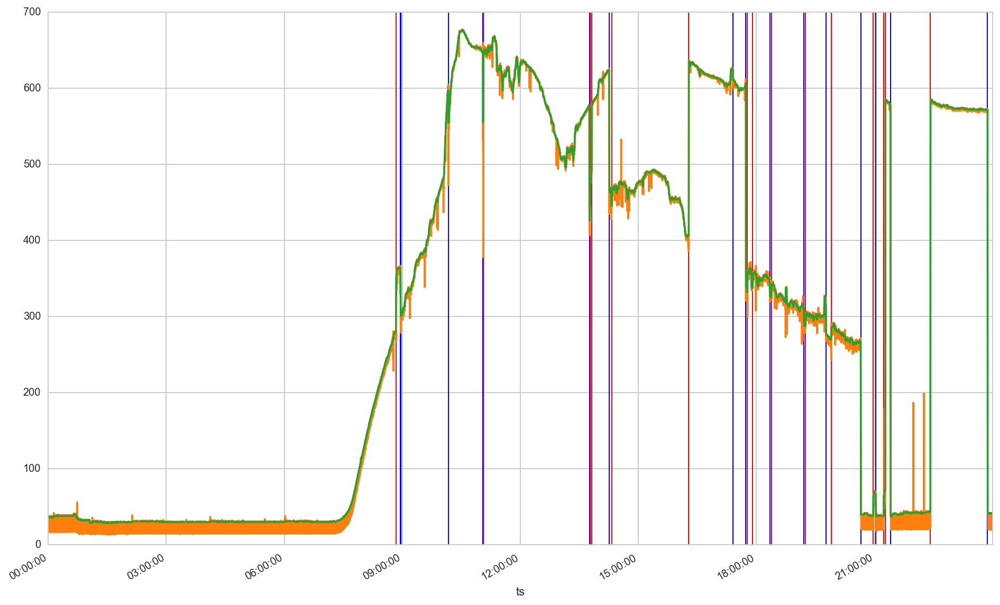

In [288]:
ax = day.raw_ldr.plot(figsize=FS, color=tableau20[2])
day.median_filter.plot(ax=ax, color=tableau20[4])
ax.vlines(subidas.index, *ax.get_ylim(), color='red', lw=1)
ax.vlines(bajadas.index, *ax.get_ylim(), color='blue', lw=1)


In [388]:
#day.loc[eventos.index, 'interv'] = 1
#day.loc[eventos.index]


In [387]:
import math


latitude_rad = 0.6742462242123661
declination_rad = 0.10110116629018565
altitude_rad = -0.7233020498600453
math.degrees(altitude_rad), math.cos(altitude_rad)

#error_median.plot(figsize=FS, alpha=.6)

(-41.442154770141634, 0.749624313368173)

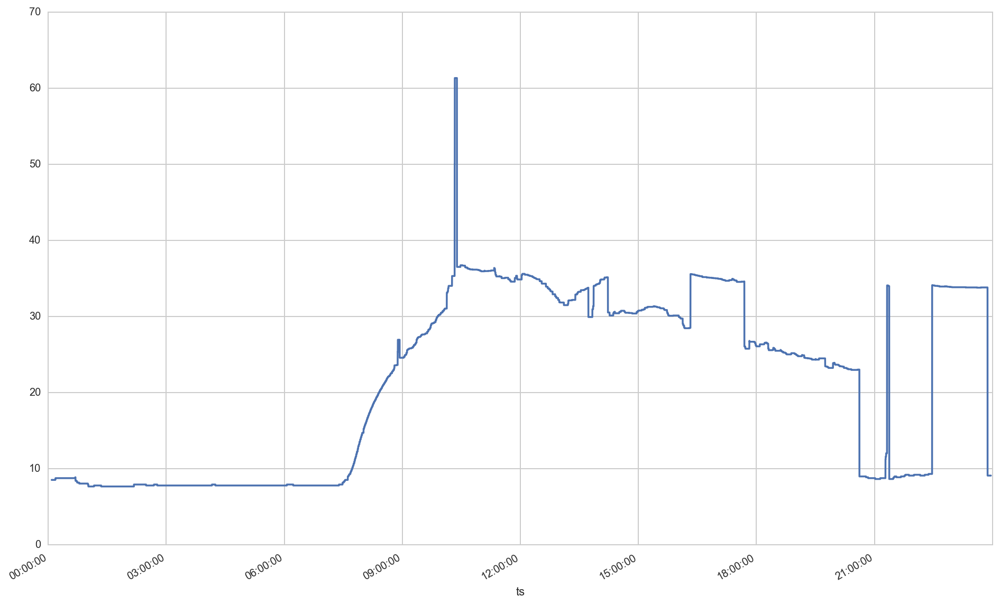

In [204]:
error_median.rolling(301, center=True).min().plot(figsize=FS)

#ax = error_median.fillna(method='ffill').rolling(15, center=True).min().plot()
#error_median.fillna(method='ffill').rolling(15, center=True).max().plot()

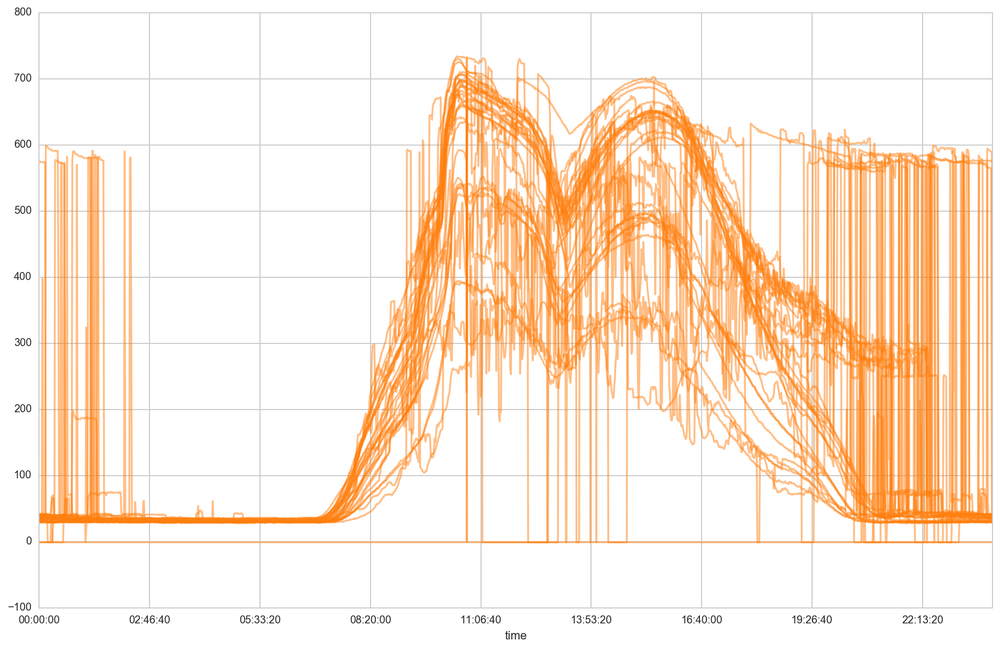

In [331]:
df_matrix_ldr_day = ldr_minutos.ldr.groupby(lambda x: x.time).apply(lambda x: pd.Series(x.values)).unstack().dropna(axis=1)

f, ax = plt.subplots(1, 1, figsize=FS)
for c in df_matrix_ldr_day:
    df_matrix_ldr_day[c].plot(ax=ax, color=tableau20[2], alpha=.5)

In [7]:
ldr_max = ((ldr_minutos.max() + 50) // 50) * 50
ldr_max, ldr_minutos.max()

(ldr    750.0
 dtype: float64, ldr    734.0
 dtype: float64)

In [3]:
ldr_minutos = LDR.resample('1s').mean().fillna(method='ffill', limit=5).fillna(method='bfill', limit=5).fillna(-1).resample('1min').median().round()

In [ ]:
x = ldr_minutos.index.hour * 60 + ldr_minutos.index.minute
y = ldr_minutos.values
#x, y = x[:10000], y[:10000]

# xlim=(0, 60*24), ylim=(0, ldr_max), marginal_kws=dict(bins=144)
g = sns.jointplot(x, y, kind='hex', color="#4CB391", size=8, ratio=7, space=0, 
                 )
g.set_axis_labels('Horas', 'LDR level')
#g = sns.jointplot(x, y)
#g

In [13]:
y.shape, x.shape

((10000, 1), (10000,))

In [1]:
ldr_minutos

NameError: name 'ldr_minutos' is not defined